## Allen SDK

In [1]:
!pip install allensdk

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.8 MB 30.5 MB/s 
     |████████████████████████████████| 54 kB 1.2 MB/s 
     |████████████████████████████████| 1.3 MB 31.5 MB/s 
     |████████████████████████████████| 4.3 MB 65.2 MB/s 
     |████████████████████████████████| 130 kB 54.3 MB/s 
     |████████████████████████████████| 668 kB 61.4 MB/s 
     |████████████████████████████████| 77 kB 5.7 MB/s 
     |████████████████████████████████| 3.4 MB 50.1 MB/s 
     |████████████████████████████████| 185 kB 42.8 MB/s 
     |████████████████████████████████| 48.4 MB 31 kB/s 
     |████████████████████████████████| 3.0 MB 49.2 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 26.5 MB 1.3 MB/s 
     |████████████████████████████████| 130 kB 40.8 MB/s 
     |████████████████████

# Importing Librarires

In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from allensdk.brain_observatory.ecephys.ecephys_project_cache import EcephysProjectCache
from scipy.stats import binned_statistic
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.pyplot import cm
from cycler import cycler
from numpy import trapz

# Helper Functions

In [3]:
def plot_correlated_heatmap(stimulus_ids,unit_id,title='',time_steps = 0.01,duration = 0.25):
  time_bins = np.arange(0.0,duration+time_steps,time_steps)
  #print(time_bins)
  #Histogram is of xarray data set with 3 dimensions
  #Histograms has coordinates stimulus_presentaion_ids,time relative to stimulus onset , unit ids
  histogram = session.presentationwise_spike_counts(stimulus_presentation_ids=stimulus_ids,bin_edges = time_bins,unit_ids=unit_id )
  #compressing the data by taking mean along stimulus presentation id
  mean_histogram = histogram.mean(dim='stimulus_presentation_id')
  df = pd.DataFrame(data= np.array(mean_histogram),columns=[i for i in range(len(unit_id))])
  #print('time bins = ',df.shape[0])
  plt.figure(figsize=(12,9))
  plt.title(title)
  sns.heatmap(data =df.corr() ,cmap="YlGnBu")
  return df
#Helper pseudo function
def _plot_correlated_heatmap(stimulus_ids,unit_id,title='',time_steps = 0.01,duration = 0.25):
  time_bins = np.arange(0.0,duration+time_steps,time_steps)
  #print(time_bins)
  #Histogram is of xarray data set with 3 dimensions
  #Histograms has coordinates stimulus_presentaion_ids,time relative to stimulus onset , unit ids
  histogram = session.presentationwise_spike_counts(stimulus_presentation_ids=stimulus_ids,bin_edges = time_bins,unit_ids=unit_id )
  #compressing the data by taking mean along stimulus presentation id
  mean_histogram = histogram.mean(dim='stimulus_presentation_id')
  df = pd.DataFrame(data= np.array(mean_histogram),columns=[i for i in range(len(unit_id))])
  #print('time bins = ',df.shape[0])
  #plt.figure(figsize=(12,9))
  #plt.title(title)
  #sns.heatmap(data =df.corr() ,cmap="YlGnBu")
  return df
def sorted_dataframe(stimulus_table):
  stimulus_table = stimulus_table.dropna()
  stimulus_table_sorted = stimulus_table.sort_values(['stimulus_block','orientation'])
  orientation = np.unique(stimulus_table[stimulus_table['orientation']!='null']['orientation'])
  for degree in orientation:
    stimulus_presentation_id = stimulus_table_sorted[stimulus_table_sorted['orientation']==degree].index.values
    unit_id = snr_3_units.index.values
    plot_correlated_heatmap(stimulus_presentation_id,unit_id,str(degree))
    '''pairs = []
    for i in range(len(df)):
      print(i)
      for j in range(i+1,len(df)):
        print(j)
        if df.corr()[i][j]>0.7:
          pairs.append([i,j])
    print(pairs)'''

  #return df

def plot_binned_spike_trains(stimulus_id ,unit_id  , time_steps ,duration,ms=True ):
  df = _plot_correlated_heatmap(stimulus_ids=stimulus_id,unit_id=unit_id,title='',time_steps = time_steps,duration = duration)
  fig = plt.figure(figsize=(20,10))
  ax = fig.add_axes([0,0,1,1])
  color = iter(cm.nipy_spectral(np.linspace(0,1, len(unit_id))))
  activity = []
  unit_ids = []
  for i in range(len(unit_id)):
    c = next(color)
    unit_index = np.where(Visual_cortex_units.index.values==unit_id[i])[0][0]
    unit_ids.append(unit_index)
    ax.plot(np.arange(0,len(df)),df[i],label='unit-'+str(unit_index),c=c,alpha = 0.5 , marker = 'o')
    activity.append(df[i].sum())
  ax.set_ylabel('Mean spikes')
  ax.set_xlabel('time bins')
  fig2 = plt.figure(figsize=(20,10))
  fig2.suptitle('Activity vs Units')
  ax2 = fig2.add_axes([0,0,1,1])
  ax2.set_ylabel('Activity')
  ax2.set_xlabel('Units')
  ax2.plot(unit_ids,activity,marker='o',c=c)
  ax.legend()
  top_5 = sorted(range(len(activity)), key=lambda i: activity[i])[-5:]
  print('Top 5 units are ' , top_5)
  
  
  print('spike counts  = ' ,np.around(sorted(activity)[-5:],2) )

def _plot_binned_spike_trains(stimulus_id ,unit_id  , time_steps ,duration,ms=True ):
  df = _plot_correlated_heatmap(stimulus_ids=stimulus_id,unit_id=unit_id,title='',time_steps = time_steps,duration = duration)
  #fig = plt.figure(figsize=(20,10))
  #ax = fig.add_axes([0,0,1,1])
  #color = iter(cm.nipy_spectral(np.linspace(0,1, len(unit_id))))
  activity = []
  #unit_ids = []
  for i in range(len(unit_id)):
    #c = next(color)
    #unit_index = np.where(Visual_cortex_units.index.values==unit_id[i])[0][0]
    #unit_ids.append(unit_index)
    #ax.plot(np.arange(0,len(df)),df[i],label='unit-'+str(unit_index),c=c,alpha = 0.5 , marker = 'o')
    activity.append(df[i].sum())
  #ax.set_ylabel('Mean spikes')
  #ax.set_xlabel('time bins')
  #fig2 = plt.figure(figsize=(20,10))
  #fig2.suptitle('Activity vs Units')
  #ax2 = fig2.add_axes([0,0,1,1])
  #ax2.set_ylabel('Activity')
  #ax2.set_xlabel('Units')
  #ax2.plot(unit_ids,activity,marker='o',c=c)
  #ax.legend()
  top_5 = sorted(range(len(activity)), key=lambda i: activity[i])[-5:]
  print('Top 5 units are ' , top_5)
  

  print('spike counts  = ' ,np.around(sorted(activity)[-5:],2) )


# Creating Ecephys Project Cache Object

In [19]:
pwd


'/content/drive/MyDrive'

In [20]:
manifest_path = os.path.join('/content/drive/MyDrive','manifest.json')
cache = EcephysProjectCache.from_warehouse(manifest=manifest_path)
print(cache.get_all_session_types)

<bound method EcephysProjectCache.get_all_session_types of <allensdk.brain_observatory.ecephys.ecephys_project_cache.EcephysProjectCache object at 0x7efe43ba9bd0>>


In [21]:
sessions = cache.get_session_table()
#sessions = pd.read_csv('sessions.csv')

In [23]:
sessions.head()

,published_at,specimen_id,session_type,age_in_days,sex,full_genotype,unit_count,channel_count,probe_count,ecephys_structure_acronyms
id,,,,,,,,,,
715093703,2019-10-03T00:00:00Z,699733581,brain_observatory_1.1,118.0,M,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,884,2219,6,"[CA1, VISrl, nan, PO, LP, LGd, CA3, DG, VISl, ..."
719161530,2019-10-03T00:00:00Z,703279284,brain_observatory_1.1,122.0,M,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,755,2214,6,"[TH, Eth, APN, POL, LP, DG, CA1, VISpm, nan, N..."
721123822,2019-10-03T00:00:00Z,707296982,brain_observatory_1.1,125.0,M,Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,444,2229,6,"[MB, SCig, PPT, NOT, DG, CA1, VISam, nan, LP, ..."
732592105,2019-10-03T00:00:00Z,717038288,brain_observatory_1.1,100.0,M,wt/wt,824,1847,5,"[grey, VISpm, nan, VISp, VISl, VISal, VISrl]"
737581020,2019-10-03T00:00:00Z,718643567,brain_observatory_1.1,108.0,M,wt/wt,568,2218,6,"[grey, VISmma, nan, VISpm, VISp, VISl, VISrl]"


#Sessions Table

In [6]:
sessions.head()

,published_at,specimen_id,session_type,age_in_days,sex,full_genotype,unit_count,channel_count,probe_count,ecephys_structure_acronyms
id,,,,,,,,,,
715093703,2019-10-03T00:00:00Z,699733581,brain_observatory_1.1,118.0,M,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,884,2219,6,"[CA1, VISrl, nan, PO, LP, LGd, CA3, DG, VISl, ..."
719161530,2019-10-03T00:00:00Z,703279284,brain_observatory_1.1,122.0,M,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,755,2214,6,"[TH, Eth, APN, POL, LP, DG, CA1, VISpm, nan, N..."
721123822,2019-10-03T00:00:00Z,707296982,brain_observatory_1.1,125.0,M,Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,444,2229,6,"[MB, SCig, PPT, NOT, DG, CA1, VISam, nan, LP, ..."
732592105,2019-10-03T00:00:00Z,717038288,brain_observatory_1.1,100.0,M,wt/wt,824,1847,5,"[grey, VISpm, nan, VISp, VISl, VISal, VISrl]"
737581020,2019-10-03T00:00:00Z,718643567,brain_observatory_1.1,108.0,M,wt/wt,568,2218,6,"[grey, VISmma, nan, VISpm, VISp, VISl, VISrl]"


Total 58 sessions are there

In [7]:
len(sessions)

58

In [8]:
np.unique(sessions['session_type'])

array(['brain_observatory_1.1', 'functional_connectivity'], dtype=object)

In [9]:
sessions['session_type'].value_counts()

brain_observatory_1.1      32
functional_connectivity    26
Name: session_type, dtype: int64

Two type of sessions are there:

*   brain_observatory_1.1 -- 32
*   functional_connectivity -- 26



#Getting session data

In [22]:
session_id = 715093703
#session_analysis = pd.read_csv('session_715093703_analysis_metrics.csv') 
session = cache.get_session_data(session_id)
# session is an object type data

/usr/local/lib/python3.7/dist-packages/hdmf/utils.py:577: FutureWarning: DynamicTable.__init__: Using positional arguments for this method is discouraged and will be deprecated in a future major release. Please use keyword arguments to ensure future compatibility.
  warnings.warn(msg, FutureWarning)


The type of session is not pandas dataframe its in form of ecephys session

In [16]:
type(session)

allensdk.brain_observatory.ecephys.ecephys_session.EcephysSession

In [ ]:
type(sessions)

pandas.core.frame.DataFrame

In [ ]:
session.metadata

/usr/local/lib/python3.7/dist-packages/hdmf/utils.py:577: FutureWarning: DynamicTable.__init__: Using positional arguments for this method is discouraged and will be deprecated in a future major release. Please use keyword arguments to ensure future compatibility.
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/hdmf/utils.py:577: FutureWarning: DynamicTable.__init__: Using positional arguments for this method is discouraged and will be deprecated in a future major release. Please use keyword arguments to ensure future compatibility.
  warnings.warn(msg, FutureWarning)


{'age_in_days': 118.0,
 'ecephys_session_id': 715093703,
 'full_genotype': 'Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt',
 'num_channels': 2219,
 'num_probes': 6,
 'num_stimulus_presentations': 70388,
 'num_units': 884,
 'rig_equipment_name': 'NP.1',
 'session_start_time': datetime.datetime(2019, 1, 19, 0, 54, 18, tzinfo=tzoffset(None, -28800)),
 'session_type': 'brain_observatory_1.1',
 'sex': 'M',
 'specimen_name': 'Sst-IRES-Cre;Ai32-386129',
 'stimulus_names': ['spontaneous',
  'gabors',
  'flashes',
  'drifting_gratings',
  'natural_movie_three',
  'natural_movie_one',
  'static_gratings',
  'natural_scenes'],
 'structure_acronyms': ['PO',
  'PoT',
  'LP',
  'DG',
  'CA1',
  'VISp',
  nan,
  'LGd',
  'CA3',
  'VISl',
  'VISrl',
  'grey',
  'VISpm',
  'VISam',
  'APN',
  'MB']}

In [ ]:
session.stimulus_names

['spontaneous',
 'gabors',
 'flashes',
 'drifting_gratings',
 'natural_movie_three',
 'natural_movie_one',
 'static_gratings',
 'natural_scenes']

No of units in different parts of Brain

In [ ]:
session.structurewise_unit_counts

CA1      145
LP       139
grey     117
LGd       82
PO        76
VISrl     76
VISp      60
VISpm     50
VISl      42
VISam     30
APN       26
DG        26
CA3       14
PoT        1
Name: ecephys_structure_acronym, dtype: int64

#Stimulus Table 
contains stimulus names and the order in which the stimulus is presented

In [ ]:
stimulus_table = session.get_stimulus_table()
stimulus_table.head()

/usr/local/lib/python3.7/dist-packages/hdmf/utils.py:577: FutureWarning: DynamicTable.__init__: Using positional arguments for this method is discouraged and will be deprecated in a future major release. Please use keyword arguments to ensure future compatibility.
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/hdmf/utils.py:577: FutureWarning: DynamicTable.__init__: Using positional arguments for this method is discouraged and will be deprecated in a future major release. Please use keyword arguments to ensure future compatibility.
  warnings.warn(msg, FutureWarning)


,color,contrast,frame,orientation,phase,size,spatial_frequency,start_time,stimulus_block,stimulus_name,stop_time,temporal_frequency,x_position,y_position,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,,,,,,
0,null,null,null,null,null,null,null,13.470683,null,spontaneous,73.537433,null,null,null,60.066750,0
1,null,0.8,null,45.0,"[3644.93333333, 3644.93333333]","[20.0, 20.0]",0.08,73.537433,0.0,gabors,73.770952,4.0,0.0,30.0,0.233519,1
2,null,0.8,null,0.0,"[3644.93333333, 3644.93333333]","[20.0, 20.0]",0.08,73.770952,0.0,gabors,74.021150,4.0,-30.0,-10.0,0.250199,2
3,null,0.8,null,45.0,"[3644.93333333, 3644.93333333]","[20.0, 20.0]",0.08,74.021150,0.0,gabors,74.271349,4.0,10.0,20.0,0.250199,3
4,null,0.8,null,0.0,"[3644.93333333, 3644.93333333]","[20.0, 20.0]",0.08,74.271349,0.0,gabors,74.521547,4.0,-40.0,-40.0,0.250199,4


In [ ]:
stimulus_table['stimulus_condition_id'].value_counts()

4796    189
245      75
244      75
5026     50
4927     50
       ... 
2444     10
2445     10
2446     10
2447     10
2513     10
Name: stimulus_condition_id, Length: 5027, dtype: int64

In [ ]:
stimulus_table[stimulus_table['stimulus_condition_id']==4796]

,color,contrast,frame,orientation,phase,size,spatial_frequency,start_time,stimulus_block,stimulus_name,stop_time,temporal_frequency,x_position,y_position,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,,,,,,
49441,null,null,null,null,null,"[250.0, 250.0]",null,5384.240544,8.0,static_gratings,5384.490745,null,null,null,0.250201,4796
49462,null,null,null,null,null,"[250.0, 250.0]",null,5389.494910,8.0,static_gratings,5389.745122,null,null,null,0.250211,4796
49504,null,null,null,null,null,"[250.0, 250.0]",null,5400.003693,8.0,static_gratings,5400.253902,null,null,null,0.250209,4796
49513,null,null,null,null,null,"[250.0, 250.0]",null,5402.255582,8.0,static_gratings,5402.505780,null,null,null,0.250199,4796
49557,null,null,null,null,null,"[250.0, 250.0]",null,5413.264756,8.0,static_gratings,5413.514955,null,null,null,0.250199,4796
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70251,null,null,null,null,null,"[250.0, 250.0]",null,9100.861689,14.0,static_gratings,9101.111893,null,null,null,0.250204,4796
70253,null,null,null,null,null,"[250.0, 250.0]",null,9101.362112,14.0,static_gratings,9101.612330,null,null,null,0.250219,4796
70357,null,null,null,null,null,"[250.0, 250.0]",null,9127.383854,14.0,static_gratings,9127.634065,null,null,null,0.250211,4796


# Stimulus names 
and how many time they are presented in a session

In [ ]:
stimulus_table['stimulus_name'].value_counts()

natural_movie_three    36000
natural_movie_one      18000
static_gratings         6000
natural_scenes          5950
gabors                  3645
drifting_gratings        628
flashes                  150
spontaneous               15
Name: stimulus_name, dtype: int64

# Time duration for each presentation of a stimulus



1. Movie one and three ---- 0.01 - 0.06 seconds
2. Static Grating      ----  





In [ ]:
stimulus_table[stimulus_table['stimulus_name']=='natural_movie_three']['duration'].value_counts()

NameError: ignored

In [ ]:
stimulus_table[stimulus_table['stimulus_name']=='natural_movie_one']['duration'].value_counts()

movie one and three lies from 0.01 to 0.06 seconds 

In [ ]:
stimulus_table[stimulus_table['stimulus_name']=='static_gratings']['duration'].value_counts()

So the time duration for static grating is 0.25 seconds approx ever time it is shown

In [ ]:
stimulus_table[stimulus_table['stimulus_name']=='flashes']['duration'].value_counts()

So the time duration for flashes is 0.25 seconds approx ever time it is shown

In [ ]:
stimulus_table[stimulus_table['stimulus_name']=='natural_scenes']['duration'].value_counts()

Same for natural scenes as well

In [ ]:
stimulus_table[stimulus_table['stimulus_name']=='gabors']['duration'].value_counts()

Gabors is shown for 0.25 seconds as well

In [ ]:
stimulus_table[stimulus_table['stimulus_name']=='drifting_gratings']['duration'].value_counts()

Drifting grating is shown for 2 seconds approx every time

# Different Stimulus Tables

In [11]:
natural_movie_one = session.get_stimulus_table('natural_movie_one')
natural_movie_three = session.get_stimulus_table('natural_movie_three')
static_grating_stimulus = session.get_stimulus_table('static_gratings')
natural_scenes_stimulus = session.get_stimulus_table('natural_scenes')
gabors_stimulus = session.get_stimulus_table('gabors')
drifting_gratings_stimulus = session.get_stimulus_table('drifting_gratings')
flashes_stimulus = session.get_stimulus_table('flashes')
spontaneous_stimulus = session.get_stimulus_table('spontaneous')

/usr/local/lib/python3.7/dist-packages/hdmf/utils.py:577: FutureWarning: DynamicTable.__init__: Using positional arguments for this method is discouraged and will be deprecated in a future major release. Please use keyword arguments to ensure future compatibility.
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/hdmf/utils.py:577: FutureWarning: DynamicTable.__init__: Using positional arguments for this method is discouraged and will be deprecated in a future major release. Please use keyword arguments to ensure future compatibility.
  warnings.warn(msg, FutureWarning)


# Units 
Basically neurons 

In [12]:
units = session.units

/usr/local/lib/python3.7/dist-packages/hdmf/utils.py:577: FutureWarning: DynamicTable.__init__: Using positional arguments for this method is discouraged and will be deprecated in a future major release. Please use keyword arguments to ensure future compatibility.
  warnings.warn(msg, FutureWarning)


Using units with High Signal to noise ration(snr)

In [25]:
units.head()

,snr,presence_ratio,waveform_spread,cumulative_drift,isolation_distance,waveform_amplitude,firing_rate,nn_hit_rate,isi_violations,waveform_velocity_below,...,ecephys_structure_id,ecephys_structure_acronym,anterior_posterior_ccf_coordinate,dorsal_ventral_ccf_coordinate,left_right_ccf_coordinate,probe_description,location,probe_sampling_rate,probe_lfp_sampling_rate,probe_has_lfp_data
unit_id,,,,,,,,,,,,,,,,,,,,,
950910352,2.816993,0.99,60.0,419.57,69.455405,106.785900,4.532385,0.935531,0.029797,0.000000,...,215.0,APN,8157.0,3521.0,6697.0,probeA,See electrode locations,29999.954846,1249.998119,True
950910364,2.592082,0.99,60.0,231.42,102.847616,85.808775,31.486161,0.995333,0.005998,0.343384,...,215.0,APN,8154.0,3513.0,6698.0,probeA,See electrode locations,29999.954846,1249.998119,True
950910371,2.095077,0.99,70.0,209.31,76.907610,76.898055,17.328610,0.993333,0.005242,0.137353,...,215.0,APN,8146.0,3487.0,6701.0,probeA,See electrode locations,29999.954846,1249.998119,True
950910392,3.024744,0.99,70.0,179.71,65.671206,120.519555,16.262414,0.944000,0.096884,-0.274707,...,215.0,APN,8133.0,3444.0,6707.0,probeA,See electrode locations,29999.954846,1249.998119,True
950910435,2.067406,0.99,90.0,99.99,294.002222,66.974895,62.326305,1.000000,0.004243,-0.647523,...,215.0,APN,8110.0,3367.0,6719.0,probeA,See electrode locations,29999.954846,1249.998119,True


In [13]:
Visual_cortex_units_snr_3 = units[(units['ecephys_structure_acronym']=='VISp') & (units['snr']>3)]
Visual_cortex_units_snr_1_3 = units[(units['ecephys_structure_acronym']=='VISp') & (units['snr']<=3)]


In [14]:
Visual_cortex_units = pd.concat([Visual_cortex_units_snr_3 ,Visual_cortex_units_snr_1_3],axis=0)

In [15]:
other_units = units[(units['ecephys_structure_acronym']!='VISp')]
all_units = pd.concat([Visual_cortex_units,other_units],axis=0)
Visual_cortex_units.head()

,snr,presence_ratio,waveform_spread,cumulative_drift,isolation_distance,waveform_amplitude,firing_rate,nn_hit_rate,isi_violations,waveform_velocity_below,...,ecephys_structure_id,ecephys_structure_acronym,anterior_posterior_ccf_coordinate,dorsal_ventral_ccf_coordinate,left_right_ccf_coordinate,probe_description,location,probe_sampling_rate,probe_lfp_sampling_rate,probe_has_lfp_data
unit_id,,,,,,,,,,,,,,,,,,,,,
950930340,3.871752,0.97,60.0,51.22,55.450465,183.61161,1.674368,0.930000,0.000000,0.000000,...,385.0,VISp,8596.0,1416.0,8207.0,probeC,See electrode locations,29999.98547,1249.999395,True
950930407,3.446565,0.99,50.0,78.79,143.663038,139.34388,52.195576,0.997333,0.005406,-0.343384,...,385.0,VISp,8599.0,1404.0,8206.0,probeC,See electrode locations,29999.98547,1249.999395,True
950930522,3.179811,0.99,40.0,119.85,40.220730,147.27102,4.295951,0.810398,0.151357,-0.686767,...,385.0,VISp,8606.0,1367.0,8202.0,probeC,See electrode locations,29999.98547,1249.999395,True
950930866,3.280032,0.99,50.0,190.02,57.674502,164.60262,4.970599,0.897872,0.184995,0.343384,...,385.0,VISp,8616.0,1318.0,8196.0,probeC,See electrode locations,29999.98547,1249.999395,True
950930985,4.318598,0.99,60.0,59.32,195.199382,223.70907,45.575224,0.999333,0.001100,-0.412060,...,385.0,VISp,8623.0,1281.0,8191.0,probeC,See electrode locations,29999.98547,1249.999395,True


In [ ]:
all_units

,snr,presence_ratio,waveform_spread,cumulative_drift,isolation_distance,waveform_amplitude,firing_rate,nn_hit_rate,isi_violations,waveform_velocity_below,...,ecephys_structure_id,ecephys_structure_acronym,anterior_posterior_ccf_coordinate,dorsal_ventral_ccf_coordinate,left_right_ccf_coordinate,probe_description,location,probe_sampling_rate,probe_lfp_sampling_rate,probe_has_lfp_data
unit_id,,,,,,,,,,,,,,,,,,,,,
950930340,3.871752,0.97,60.0,51.22,55.450465,183.61161,1.674368,0.930000,0.000000,0.000000,...,385.0,VISp,8596.0,1416.0,8207.0,probeC,See electrode locations,29999.985470,1249.999395,True
950930407,3.446565,0.99,50.0,78.79,143.663038,139.34388,52.195576,0.997333,0.005406,-0.343384,...,385.0,VISp,8599.0,1404.0,8206.0,probeC,See electrode locations,29999.985470,1249.999395,True
950930522,3.179811,0.99,40.0,119.85,40.220730,147.27102,4.295951,0.810398,0.151357,-0.686767,...,385.0,VISp,8606.0,1367.0,8202.0,probeC,See electrode locations,29999.985470,1249.999395,True
950930866,3.280032,0.99,50.0,190.02,57.674502,164.60262,4.970599,0.897872,0.184995,0.343384,...,385.0,VISp,8616.0,1318.0,8196.0,probeC,See electrode locations,29999.985470,1249.999395,True
950930985,4.318598,0.99,60.0,59.32,195.199382,223.70907,45.575224,0.999333,0.001100,-0.412060,...,385.0,VISp,8623.0,1281.0,8191.0,probeC,See electrode locations,29999.985470,1249.999395,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
950956911,1.689921,0.99,130.0,166.36,36.995342,91.26468,5.890958,0.370000,0.270592,0.068677,...,417.0,VISrl,7295.0,1020.0,8734.0,probeF,See electrode locations,30000.028033,1250.001168,True
950956870,5.216742,0.99,60.0,121.49,80.682448,311.72349,0.647343,0.985507,0.092982,0.000000,...,417.0,VISrl,7295.0,1020.0,8734.0,probeF,See electrode locations,30000.028033,1250.001168,True
950956845,3.841410,0.99,70.0,235.47,63.765826,137.34825,2.075303,0.938438,0.262364,0.068677,...,417.0,VISrl,7298.0,1031.0,8730.0,probeF,See electrode locations,30000.028033,1250.001168,True


#Analysis of Different Stimulus

##Static Grating

In [ ]:
static_grating_stimulus.head()

,contrast,orientation,phase,size,spatial_frequency,start_time,stimulus_block,stimulus_name,stop_time,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,
49432,0.8,120.0,0.5,"[250.0, 250.0]",0.32,5381.988653,8.0,static_gratings,5382.238857,0.250204,4787
49433,0.8,150.0,0.5,"[250.0, 250.0]",0.08,5382.238857,8.0,static_gratings,5382.489060,0.250204,4788
49434,0.8,60.0,0.5,"[250.0, 250.0]",0.32,5382.489060,8.0,static_gratings,5382.739264,0.250204,4789
49435,0.8,120.0,0.75,"[250.0, 250.0]",0.04,5382.739264,8.0,static_gratings,5382.989467,0.250204,4790
49436,0.8,150.0,0.0,"[250.0, 250.0]",0.02,5382.989467,8.0,static_gratings,5383.239686,0.250219,4791


In [ ]:
mean_duration_static = static_grating_stimulus['duration'].mean()
mean_duration_static

0.2502089916666667

In [ ]:
len(static_grating_stimulus)

6000

In [ ]:
static_grating_stimulus.loc[49432]

contrast                             0.8
orientation                        120.0
phase                                0.5
size                      [250.0, 250.0]
spatial_frequency                   0.32
start_time                   5381.988653
stimulus_block                       8.0
stimulus_name            static_gratings
stop_time                    5382.238857
duration                        0.250204
stimulus_condition_id               4787
Name: 49432, dtype: object

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(24, 25), (41, 42), (50, 51), (78, 79), (82, 83), (118, 119), (122, 123), (149, 150), (157, 158), (204, 205), (216, 217), (222, 223), (224, 225)], with a maximum overlap of 0.009803640126847313 seconds.
  warnings.warn("You've specified some overlapping time intervals "
/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(53, 54), (58, 59), (89, 90), (94, 95), (100, 101), (102, 103), (123, 124), (138, 139), (221, 222)], with a maximum overlap of 0.009793859873752808 seconds.
  warnings.warn("You've specified some overlapping time intervals "
/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified so

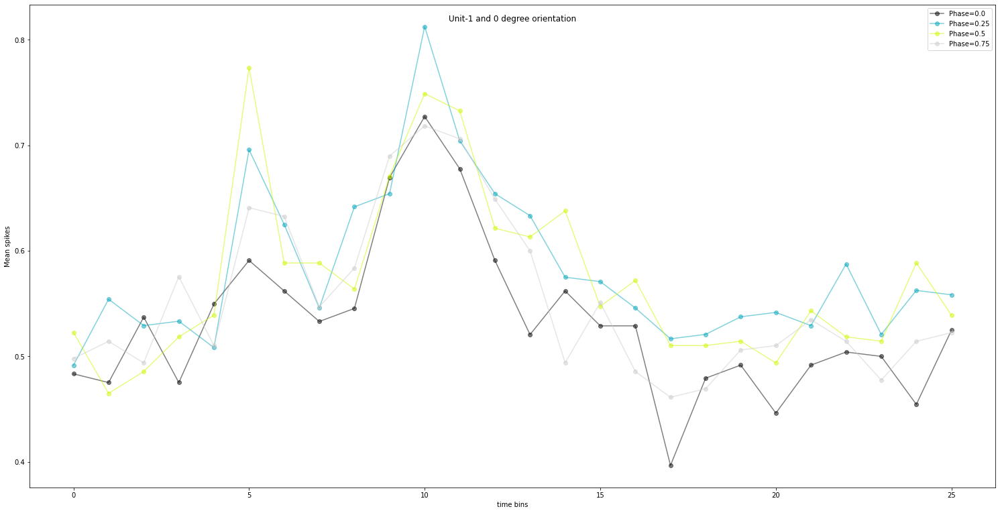

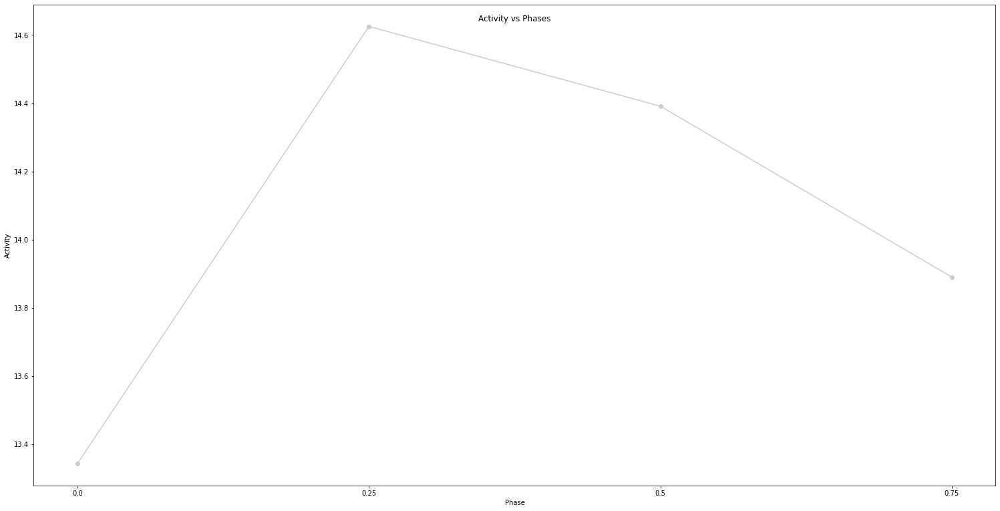

In [ ]:
phase = np.unique(static_grating_stimulus['phase'])[:-1]
fig = plt.figure(figsize=(20,10))
fig.suptitle('Unit-1 and 0 degree orientation')
color = iter(cm.nipy_spectral(np.linspace(0,1, len(phase))))
ax = fig.add_axes([0,0,1,1])
areas = []
for p in phase:
  unit_id = np.array([Visual_cortex_units.index.values[1]])
  df = _plot_correlated_heatmap(stimulus_ids=static_grating_stimulus[(static_grating_stimulus['phase']==p) &(static_grating_stimulus['orientation']==0) ].index.values,unit_id=unit_id,title='',time_steps = 0.01,duration = mean_duration_static)
  c = next(color)
  #unit_index = np.where(Visual_cortex_units.index.values==unit_id[i])[0][0]
  ax.plot(np.arange(0,len(df)),df[0],label='Phase='+str(p),c=c,alpha = 0.5 , marker = 'o')
  areas.append(trapz(df[0],dx=1))
ax.set_ylabel('Mean spikes')
ax.set_xlabel('time bins')
ax.legend()
fig2 = plt.figure(figsize=(20,10))
fig2.suptitle('Activity vs Phases')
ax2 = fig2.add_axes([0,0,1,1])
ax2.set_ylabel('Activity')
ax2.set_xlabel('Phase')
ax2.plot(phase,areas,marker='o',c=c)





### 0 degree orientation

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(4, 5), (5, 6), (12, 13), (23, 24), (38, 39), (40, 41), (48, 49), (52, 53), (66, 67), (91, 92), (94, 95), (105, 106), (108, 109), (112, 113), (121, 122), (122, 123), (124, 125), (127, 128), (145, 146), (150, 151), (152, 153), (167, 168), (174, 175), (176, 177), (181, 182), (192, 193), (195, 196), (198, 199), (200, 201), (208, 209), (209, 210), (212, 213), (224, 225), (226, 227), (227, 228), (229, 230), (238, 239), (242, 243), (244, 245), (245, 246), (252, 253), (254, 255), (262, 263), (272, 273), (275, 276), (276, 277), (285, 286), (288, 289), (295, 296), (316, 317), (320, 321), (321, 322), (330, 331), (332, 333), (333, 334), (337, 338), (344, 345), (347, 348), (349, 350), (354, 355), (359, 360), (363, 364), (365, 366), (366, 367), (370, 371), (372, 373), (376, 377), (402, 403), (406, 407), (408, 409),

Top 5 units are  [8, 13, 4, 1, 38]
spike counts  =  [ 4.85  5.94 13.65 14.58 16.29]


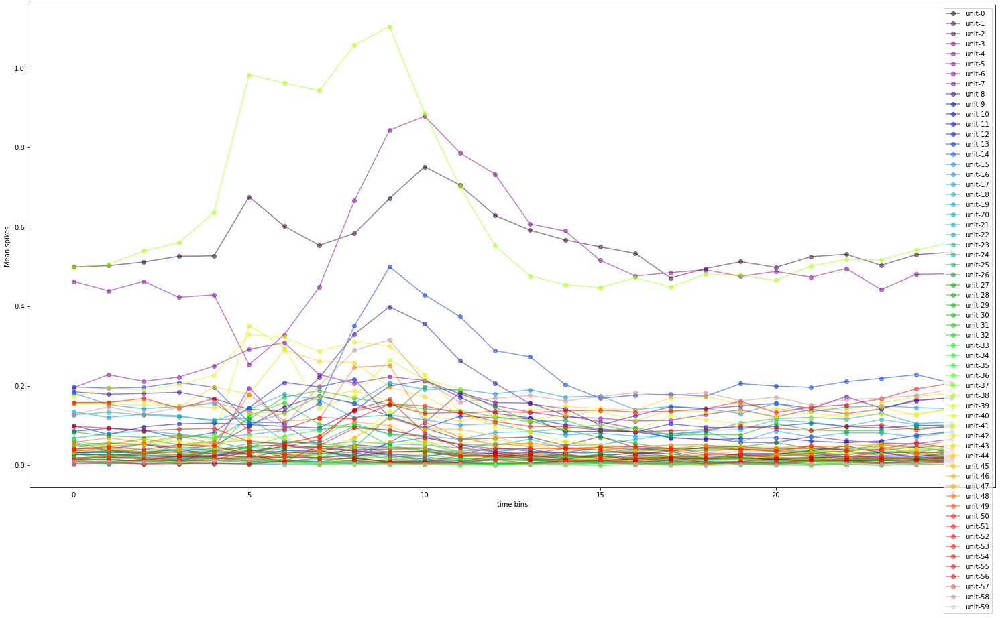

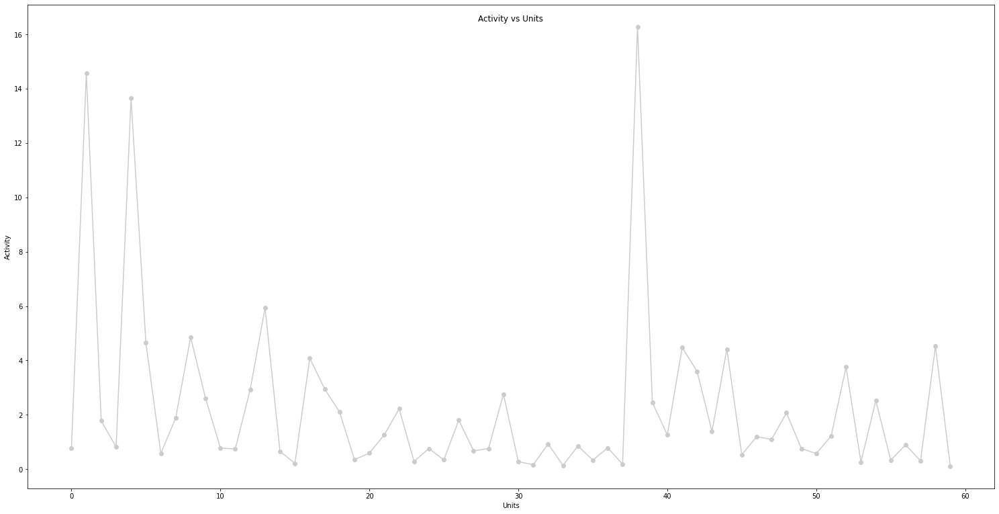

In [ ]:
plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==0].index.values,Visual_cortex_units.index.values,0.01 , mean_duration_static)

In [ ]:
_plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==0].index.values,all_units.index.values,0.01 , mean_duration_static)

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(4, 5), (5, 6), (12, 13), (23, 24), (38, 39), (40, 41), (48, 49), (52, 53), (66, 67), (91, 92), (94, 95), (105, 106), (108, 109), (112, 113), (121, 122), (122, 123), (124, 125), (127, 128), (145, 146), (150, 151), (152, 153), (167, 168), (174, 175), (176, 177), (181, 182), (192, 193), (195, 196), (198, 199), (200, 201), (208, 209), (209, 210), (212, 213), (224, 225), (226, 227), (227, 228), (229, 230), (238, 239), (242, 243), (244, 245), (245, 246), (252, 253), (254, 255), (262, 263), (272, 273), (275, 276), (276, 277), (285, 286), (288, 289), (295, 296), (316, 317), (320, 321), (321, 322), (330, 331), (332, 333), (333, 334), (337, 338), (344, 345), (347, 348), (349, 350), (354, 355), (359, 360), (363, 364), (365, 366), (366, 367), (370, 371), (372, 373), (376, 377), (402, 403), (406, 407), (408, 409),

Top 5 units are  [38, 64, 526, 500, 792]
spike counts  =  [16.29 16.86 17.15 18.71 18.75]


In [ ]:
spike_times_0_degree_static_gratings = []
for i in range(len(all_units)):
  spike_times_0_degree_static_gratings.append(session.presentationwise_spike_times(stimulus_presentation_ids=static_grating_stimulus[static_grating_stimulus['orientation']==0].index.values,unit_ids=all_units.index.values[i]).index.values)

In [42]:
spike_train_gabors = session.presentationwise_spike_times(stimulus_presentation_ids=gabors_stimulus[gabors_stimulus['orientation']==0].index.values,unit_ids=all_units.index.values[1]).index.values
spikes = {'gabors_0_degree':spike_train_gabors}
df = pd.DataFrame(spikes)
df.to_csv('gabors_0_degree.csv')

In [44]:
spike_train_gabors = session.presentationwise_spike_times(stimulus_presentation_ids=gabors_stimulus[gabors_stimulus['orientation']==45].index.values,unit_ids=all_units.index.values[1]).index.values
spikes = {'gabors_45_degree':spike_train_gabors}
df = pd.DataFrame(spikes)
df.to_csv('gabors_45_degree.csv')

In [45]:
spike_train_gabors = session.presentationwise_spike_times(stimulus_presentation_ids=gabors_stimulus[gabors_stimulus['orientation']==90].index.values,unit_ids=all_units.index.values[1]).index.values
spikes = {'gabors_90_degree':spike_train_gabors}
df = pd.DataFrame(spikes)
df.to_csv('gabors_90_degree.csv')

In [ ]:
unit_38 = all_units.index.values[38]

In [35]:
all_units

,snr,presence_ratio,waveform_spread,cumulative_drift,isolation_distance,waveform_amplitude,firing_rate,nn_hit_rate,isi_violations,waveform_velocity_below,...,ecephys_structure_id,ecephys_structure_acronym,anterior_posterior_ccf_coordinate,dorsal_ventral_ccf_coordinate,left_right_ccf_coordinate,probe_description,location,probe_sampling_rate,probe_lfp_sampling_rate,probe_has_lfp_data
unit_id,,,,,,,,,,,,,,,,,,,,,
950930340,3.871752,0.97,60.0,51.22,55.450465,183.61161,1.674368,0.930000,0.000000,0.000000,...,385.0,VISp,8596.0,1416.0,8207.0,probeC,See electrode locations,29999.985470,1249.999395,True
950930407,3.446565,0.99,50.0,78.79,143.663038,139.34388,52.195576,0.997333,0.005406,-0.343384,...,385.0,VISp,8599.0,1404.0,8206.0,probeC,See electrode locations,29999.985470,1249.999395,True
950930522,3.179811,0.99,40.0,119.85,40.220730,147.27102,4.295951,0.810398,0.151357,-0.686767,...,385.0,VISp,8606.0,1367.0,8202.0,probeC,See electrode locations,29999.985470,1249.999395,True
950930866,3.280032,0.99,50.0,190.02,57.674502,164.60262,4.970599,0.897872,0.184995,0.343384,...,385.0,VISp,8616.0,1318.0,8196.0,probeC,See electrode locations,29999.985470,1249.999395,True
950930985,4.318598,0.99,60.0,59.32,195.199382,223.70907,45.575224,0.999333,0.001100,-0.412060,...,385.0,VISp,8623.0,1281.0,8191.0,probeC,See electrode locations,29999.985470,1249.999395,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
950956911,1.689921,0.99,130.0,166.36,36.995342,91.26468,5.890958,0.370000,0.270592,0.068677,...,417.0,VISrl,7295.0,1020.0,8734.0,probeF,See electrode locations,30000.028033,1250.001168,True
950956870,5.216742,0.99,60.0,121.49,80.682448,311.72349,0.647343,0.985507,0.092982,0.000000,...,417.0,VISrl,7295.0,1020.0,8734.0,probeF,See electrode locations,30000.028033,1250.001168,True
950956845,3.841410,0.99,70.0,235.47,63.765826,137.34825,2.075303,0.938438,0.262364,0.068677,...,417.0,VISrl,7298.0,1031.0,8730.0,probeF,See electrode locations,30000.028033,1250.001168,True


In [32]:
df = session.presentationwise_spike_times(stimulus_presentation_ids=static_grating_stimulus[static_grating_stimulus['orientation']==120].index.values,unit_ids=all_units.index.values[792])
df.index.values

array([5381.9902922 , 5382.01242555, 5382.0616589 , ..., 9131.84528222,
       9131.8601489 , 9131.87201557])

In [ ]:
df['stimulus_presentation_id']

spike_time
5395.222604    49484
5395.231138    49484
5455.105415    49724
5473.368331    49797
5481.980490    49831
               ...  
9114.150029    70304
9116.219394    70312
9125.935852    70351
9126.706084    70354
9126.822951    70354
Name: stimulus_presentation_id, Length: 142, dtype: int64

### 30 degree Orientation

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(3, 4), (15, 16), (16, 17), (28, 29), (35, 36), (38, 39), (42, 43), (45, 46), (47, 48), (52, 53), (57, 58), (64, 65), (80, 81), (85, 86), (99, 100), (108, 109), (123, 124), (126, 127), (134, 135), (140, 141), (141, 142), (161, 162), (162, 163), (163, 164), (167, 168), (170, 171), (172, 173), (174, 175), (188, 189), (190, 191), (192, 193), (195, 196), (196, 197), (199, 200), (200, 201), (217, 218), (225, 226), (241, 242), (245, 246), (247, 248), (250, 251), (253, 254), (259, 260), (264, 265), (265, 266), (273, 274), (275, 276), (279, 280), (290, 291), (299, 300), (308, 309), (310, 311), (317, 318), (324, 325), (325, 326), (330, 331), (337, 338), (339, 340), (352, 353), (355, 356), (379, 380), (394, 395), (397, 398), (401, 402), (411, 412), (414, 415), (429, 430), (437, 438), (441, 442), (457, 458), (466

Top 5 units are  [13, 5, 1, 4, 38]


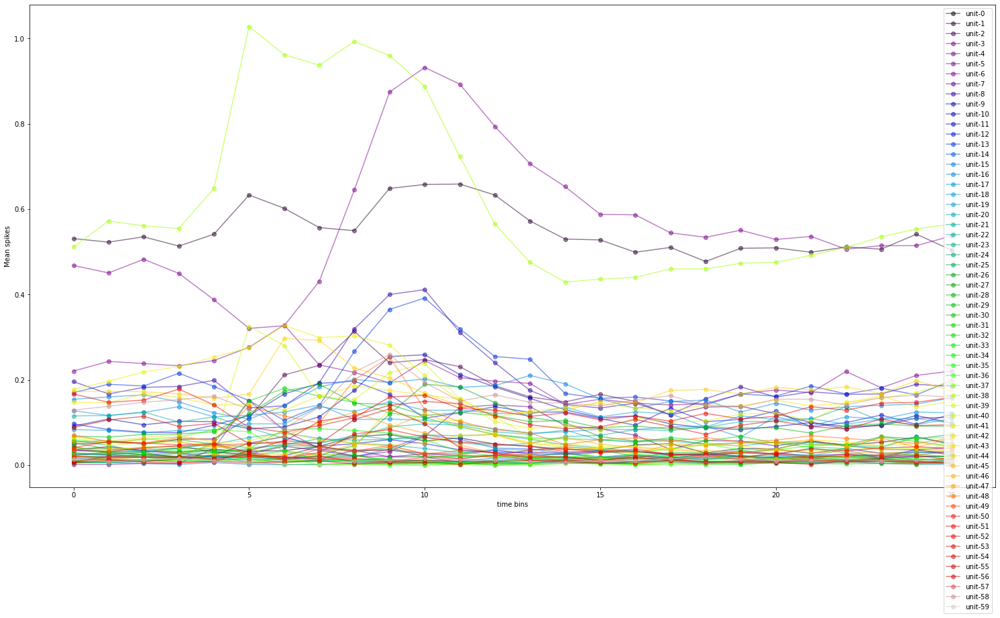

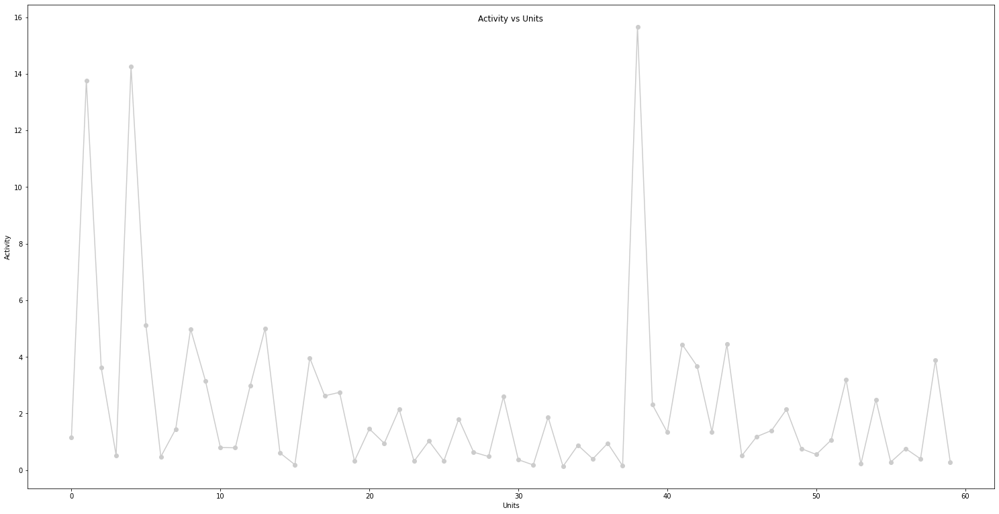

In [ ]:
plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==30].index.values,Visual_cortex_units.index.values,0.01 , mean_duration_static)

In [ ]:
_plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==30].index.values,all_units.index.values,0.01 , mean_duration_static)

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(3, 4), (15, 16), (16, 17), (28, 29), (35, 36), (38, 39), (42, 43), (45, 46), (47, 48), (52, 53), (57, 58), (64, 65), (80, 81), (85, 86), (99, 100), (108, 109), (123, 124), (126, 127), (134, 135), (140, 141), (141, 142), (161, 162), (162, 163), (163, 164), (167, 168), (170, 171), (172, 173), (174, 175), (188, 189), (190, 191), (192, 193), (195, 196), (196, 197), (199, 200), (200, 201), (217, 218), (225, 226), (241, 242), (245, 246), (247, 248), (250, 251), (253, 254), (259, 260), (264, 265), (265, 266), (273, 274), (275, 276), (279, 280), (290, 291), (299, 300), (308, 309), (310, 311), (317, 318), (324, 325), (325, 326), (330, 331), (337, 338), (339, 340), (352, 353), (355, 356), (379, 380), (394, 395), (397, 398), (401, 402), (411, 412), (414, 415), (429, 430), (437, 438), (441, 442), (457, 458), (466

Top 5 units are  [842, 64, 526, 500, 792]
spike counts  =  [16.21 16.62 17.43 18.68 19.46]


### 60 degree orientation

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(3, 4), (5, 6), (6, 7), (7, 8), (25, 26), (37, 38), (41, 42), (46, 47), (47, 48), (49, 50), (52, 53), (59, 60), (69, 70), (84, 85), (85, 86), (94, 95), (102, 103), (112, 113), (113, 114), (114, 115), (119, 120), (123, 124), (124, 125), (139, 140), (140, 141), (144, 145), (150, 151), (155, 156), (165, 166), (166, 167), (176, 177), (177, 178), (187, 188), (196, 197), (198, 199), (206, 207), (210, 211), (211, 212), (215, 216), (216, 217), (218, 219), (224, 225), (245, 246), (246, 247), (247, 248), (256, 257), (257, 258), (271, 272), (274, 275), (275, 276), (276, 277), (282, 283), (285, 286), (289, 290), (293, 294), (302, 303), (316, 317), (346, 347), (347, 348), (356, 357), (360, 361), (364, 365), (374, 375), (376, 377), (377, 378), (381, 382), (384, 385), (395, 396), (404, 405), (408, 409), (413, 414), (

Top 5 units are  [8, 5, 4, 1, 38]


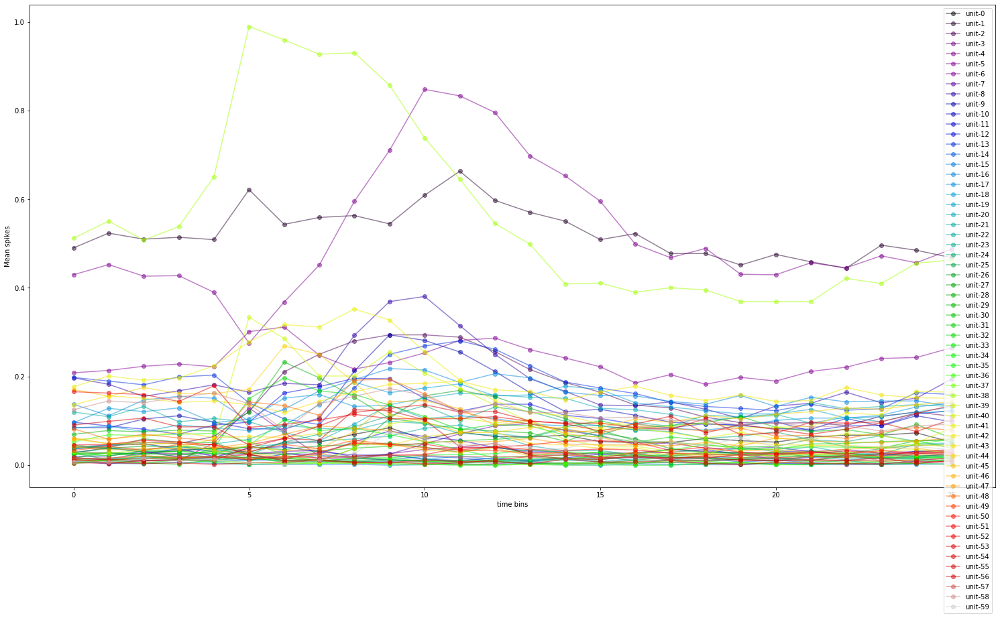

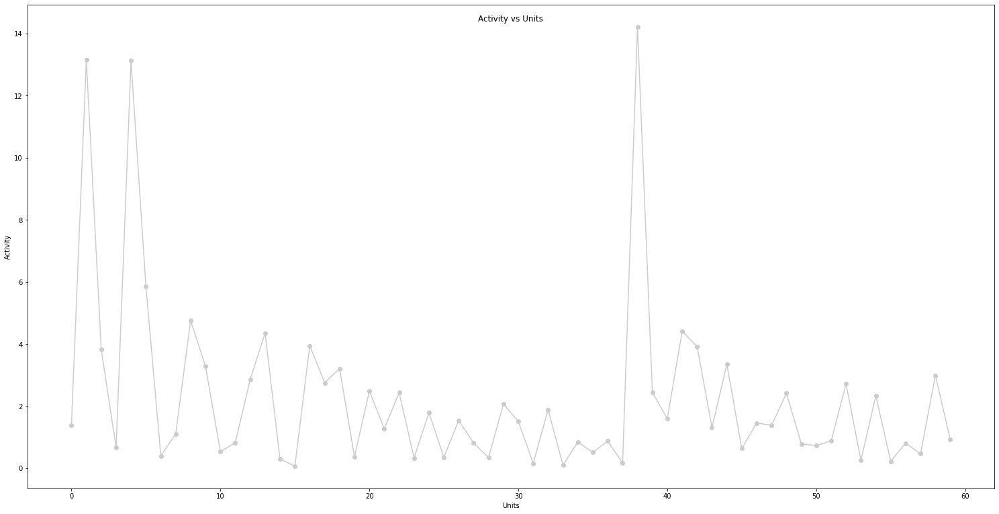

In [ ]:
plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==60].index.values,Visual_cortex_units.index.values,0.01 , mean_duration_static)

In [ ]:
_plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==60].index.values,all_units.index.values,0.01 , mean_duration_static)

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(3, 4), (5, 6), (6, 7), (7, 8), (25, 26), (37, 38), (41, 42), (46, 47), (47, 48), (49, 50), (52, 53), (59, 60), (69, 70), (84, 85), (85, 86), (94, 95), (102, 103), (112, 113), (113, 114), (114, 115), (119, 120), (123, 124), (124, 125), (139, 140), (140, 141), (144, 145), (150, 151), (155, 156), (165, 166), (166, 167), (176, 177), (177, 178), (187, 188), (196, 197), (198, 199), (206, 207), (210, 211), (211, 212), (215, 216), (216, 217), (218, 219), (224, 225), (245, 246), (246, 247), (247, 248), (256, 257), (257, 258), (271, 272), (274, 275), (275, 276), (276, 277), (282, 283), (285, 286), (289, 290), (293, 294), (302, 303), (316, 317), (346, 347), (347, 348), (356, 357), (360, 361), (364, 365), (374, 375), (376, 377), (377, 378), (381, 382), (384, 385), (395, 396), (404, 405), (408, 409), (413, 414), (

Top 5 units are  [792, 842, 526, 64, 500]
spike counts  =  [16.04 16.46 16.82 16.85 18.46]


### 90 Degree Orientation

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(0, 1), (10, 11), (11, 12), (29, 30), (31, 32), (36, 37), (46, 47), (64, 65), (70, 71), (71, 72), (78, 79), (81, 82), (82, 83), (91, 92), (92, 93), (95, 96), (96, 97), (98, 99), (99, 100), (103, 104), (126, 127), (129, 130), (132, 133), (135, 136), (139, 140), (140, 141), (161, 162), (174, 175), (182, 183), (190, 191), (192, 193), (195, 196), (199, 200), (203, 204), (207, 208), (210, 211), (219, 220), (223, 224), (227, 228), (229, 230), (235, 236), (239, 240), (246, 247), (251, 252), (259, 260), (260, 261), (275, 276), (284, 285), (288, 289), (295, 296), (299, 300), (304, 305), (306, 307), (307, 308), (326, 327), (328, 329), (333, 334), (351, 352), (356, 357), (358, 359), (359, 360), (361, 362), (370, 371), (374, 375), (375, 376), (376, 377), (379, 380), (381, 382), (382, 383), (384, 385), (388, 389), 

Top 5 units are  [41, 5, 4, 1, 38]


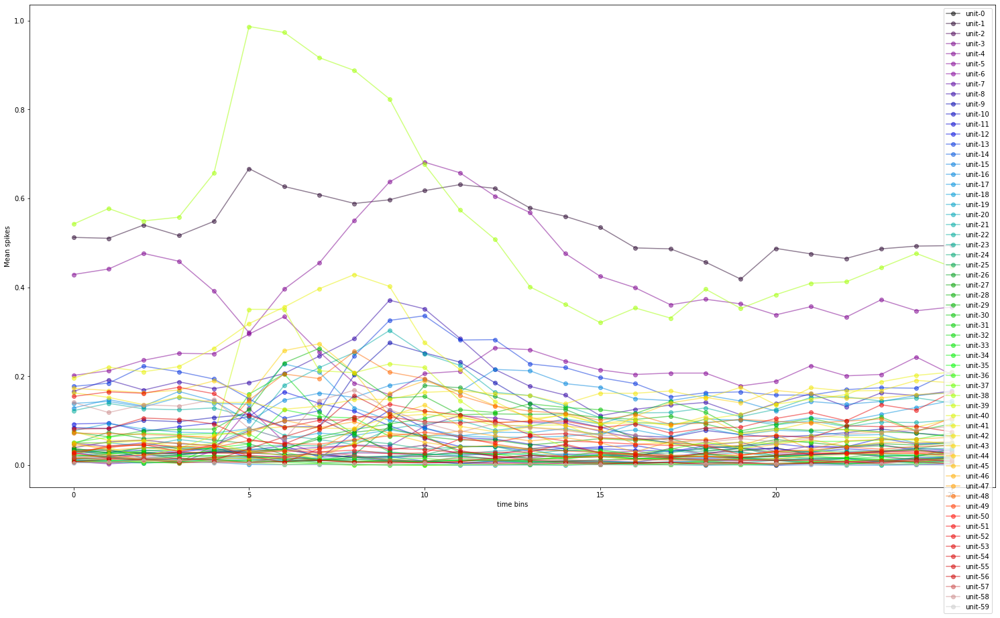

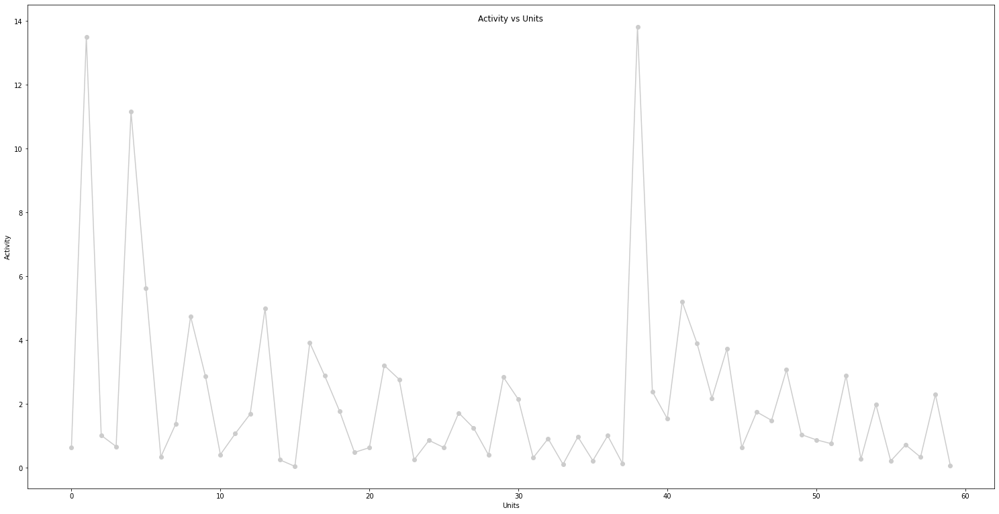

In [ ]:
plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==90].index.values,Visual_cortex_units.index.values,0.01 , mean_duration_static)

In [ ]:
_plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==90].index.values,all_units.index.values,0.01 , mean_duration_static)

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(0, 1), (10, 11), (11, 12), (29, 30), (31, 32), (36, 37), (46, 47), (64, 65), (70, 71), (71, 72), (78, 79), (81, 82), (82, 83), (91, 92), (92, 93), (95, 96), (96, 97), (98, 99), (99, 100), (103, 104), (126, 127), (129, 130), (132, 133), (135, 136), (139, 140), (140, 141), (161, 162), (174, 175), (182, 183), (190, 191), (192, 193), (195, 196), (199, 200), (203, 204), (207, 208), (210, 211), (219, 220), (223, 224), (227, 228), (229, 230), (235, 236), (239, 240), (246, 247), (251, 252), (259, 260), (260, 261), (275, 276), (284, 285), (288, 289), (295, 296), (299, 300), (304, 305), (306, 307), (307, 308), (326, 327), (328, 329), (333, 334), (351, 352), (356, 357), (358, 359), (359, 360), (361, 362), (370, 371), (374, 375), (375, 376), (376, 377), (379, 380), (381, 382), (382, 383), (384, 385), (388, 389), 

Top 5 units are  [842, 64, 71, 526, 500]
spike counts  =  [14.9  16.75 16.88 16.88 18.74]


### 120 Degree Orientation

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(6, 7), (23, 24), (34, 35), (38, 39), (49, 50), (54, 55), (58, 59), (67, 68), (81, 82), (90, 91), (97, 98), (99, 100), (104, 105), (110, 111), (111, 112), (127, 128), (131, 132), (132, 133), (134, 135), (142, 143), (143, 144), (147, 148), (150, 151), (162, 163), (175, 176), (177, 178), (189, 190), (190, 191), (194, 195), (196, 197), (202, 203), (203, 204), (211, 212), (213, 214), (215, 216), (220, 221), (226, 227), (230, 231), (232, 233), (235, 236), (253, 254), (272, 273), (274, 275), (277, 278), (279, 280), (288, 289), (289, 290), (293, 294), (304, 305), (305, 306), (317, 318), (326, 327), (328, 329), (334, 335), (339, 340), (345, 346), (351, 352), (360, 361), (363, 364), (369, 370), (372, 373), (380, 381), (383, 384), (391, 392), (401, 402), (407, 408), (414, 415), (418, 419), (420, 421), (423, 424)

Top 5 units are  [5, 8, 4, 1, 38]


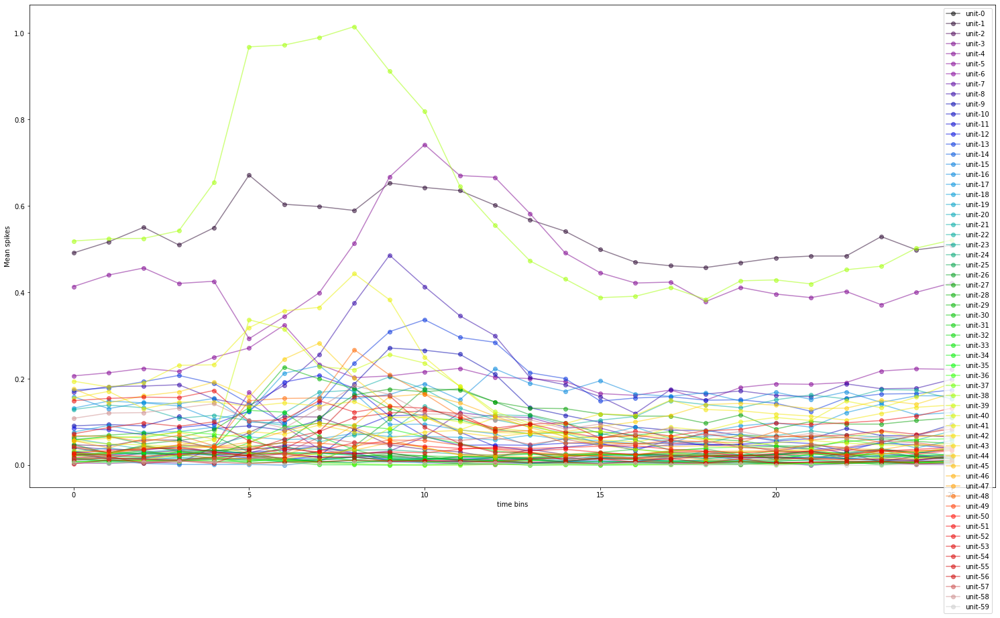

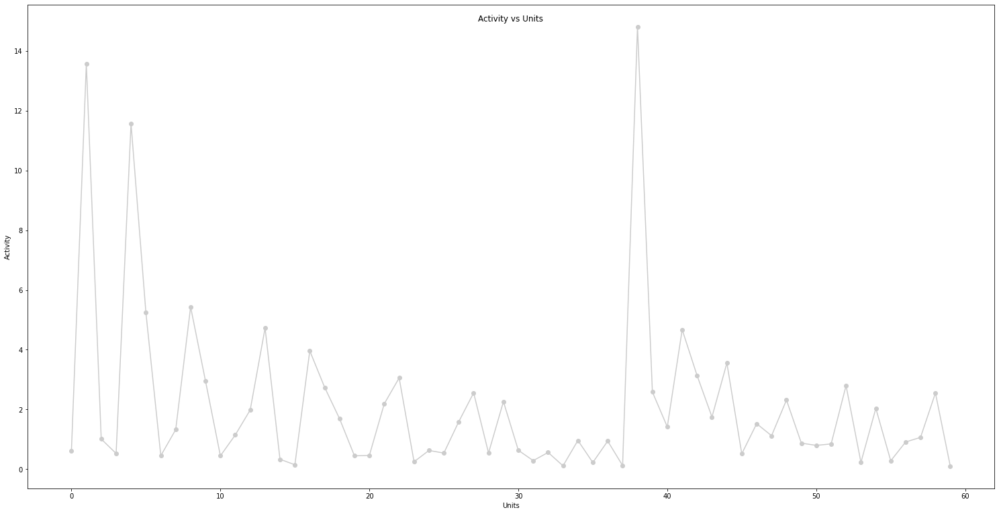

In [ ]:
plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==120].index.values,Visual_cortex_units.index.values,0.01 , mean_duration_static)

In [ ]:
_plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==120].index.values,all_units.index.values,0.01 , mean_duration_static)

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(6, 7), (23, 24), (34, 35), (38, 39), (49, 50), (54, 55), (58, 59), (67, 68), (81, 82), (90, 91), (97, 98), (99, 100), (104, 105), (110, 111), (111, 112), (127, 128), (131, 132), (132, 133), (134, 135), (142, 143), (143, 144), (147, 148), (150, 151), (162, 163), (175, 176), (177, 178), (189, 190), (190, 191), (194, 195), (196, 197), (202, 203), (203, 204), (211, 212), (213, 214), (215, 216), (220, 221), (226, 227), (230, 231), (232, 233), (235, 236), (253, 254), (272, 273), (274, 275), (277, 278), (279, 280), (288, 289), (289, 290), (293, 294), (304, 305), (305, 306), (317, 318), (326, 327), (328, 329), (334, 335), (339, 340), (345, 346), (351, 352), (360, 361), (363, 364), (369, 370), (372, 373), (380, 381), (383, 384), (391, 392), (401, 402), (407, 408), (414, 415), (418, 419), (420, 421), (423, 424)

Top 5 units are  [526, 792, 71, 64, 500]
spike counts  =  [16.65 16.77 16.79 17.13 18.92]


###150 Degree Orientation

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(6, 7), (9, 10), (13, 14), (14, 15), (15, 16), (18, 19), (19, 20), (20, 21), (21, 22), (26, 27), (28, 29), (29, 30), (45, 46), (53, 54), (55, 56), (58, 59), (68, 69), (70, 71), (75, 76), (102, 103), (109, 110), (111, 112), (115, 116), (128, 129), (145, 146), (148, 149), (154, 155), (168, 169), (172, 173), (176, 177), (180, 181), (183, 184), (186, 187), (203, 204), (205, 206), (206, 207), (211, 212), (220, 221), (221, 222), (229, 230), (237, 238), (243, 244), (245, 246), (262, 263), (264, 265), (275, 276), (280, 281), (288, 289), (298, 299), (299, 300), (310, 311), (331, 332), (332, 333), (334, 335), (339, 340), (351, 352), (367, 368), (368, 369), (371, 372), (372, 373), (375, 376), (377, 378), (378, 379), (384, 385), (388, 389), (389, 390), (392, 393), (406, 407), (407, 408), (408, 409), (419, 420), (4

Top 5 units are  [13, 8, 4, 1, 38]


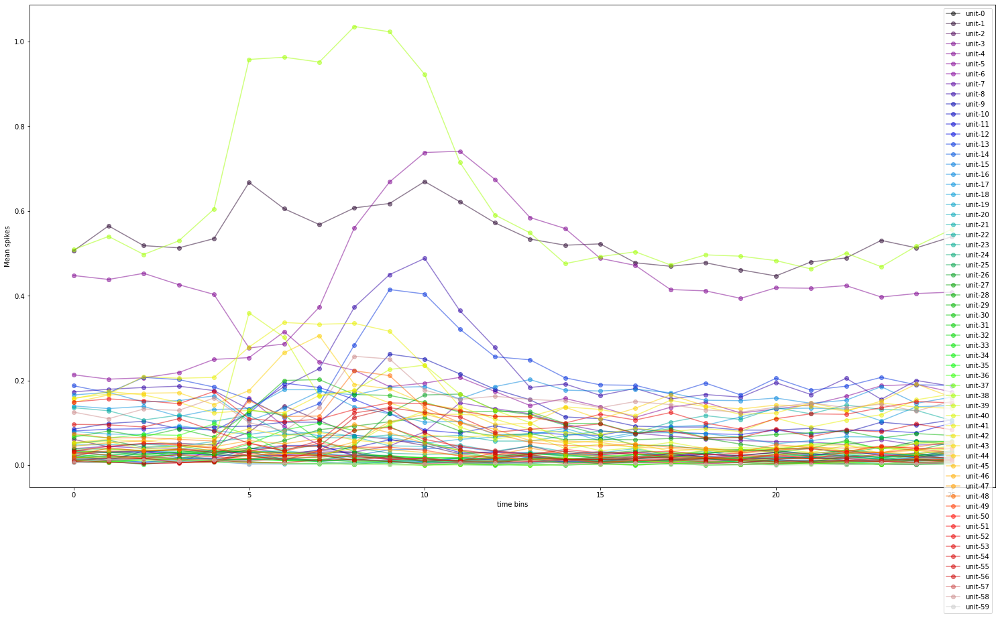

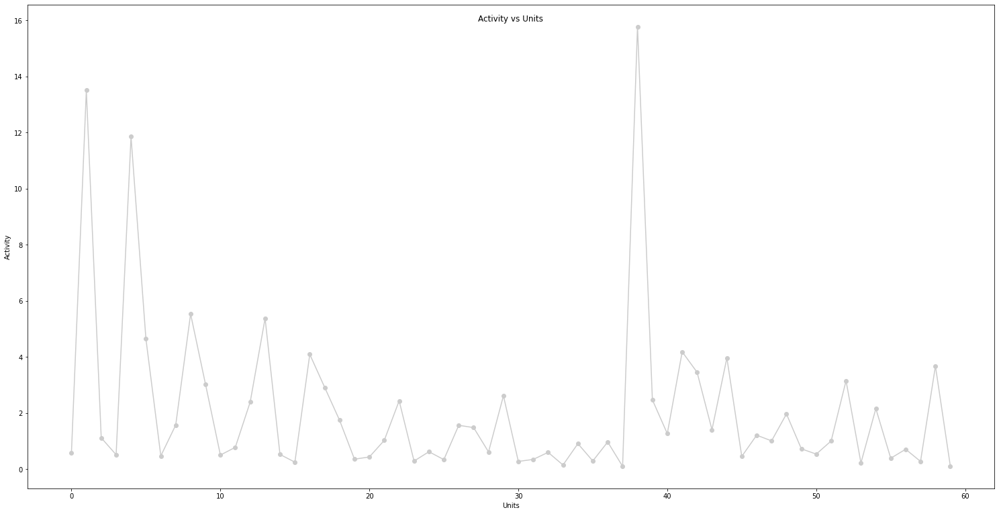

In [ ]:
plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==150].index.values,Visual_cortex_units.index.values,0.01 , mean_duration_static)

In [ ]:
_plot_binned_spike_trains(static_grating_stimulus[static_grating_stimulus['orientation']==150].index.values,all_units.index.values,0.01 , mean_duration_static)

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(6, 7), (9, 10), (13, 14), (14, 15), (15, 16), (18, 19), (19, 20), (20, 21), (21, 22), (26, 27), (28, 29), (29, 30), (45, 46), (53, 54), (55, 56), (58, 59), (68, 69), (70, 71), (75, 76), (102, 103), (109, 110), (111, 112), (115, 116), (128, 129), (145, 146), (148, 149), (154, 155), (168, 169), (172, 173), (176, 177), (180, 181), (183, 184), (186, 187), (203, 204), (205, 206), (206, 207), (211, 212), (220, 221), (221, 222), (229, 230), (237, 238), (243, 244), (245, 246), (262, 263), (264, 265), (275, 276), (280, 281), (288, 289), (298, 299), (299, 300), (310, 311), (331, 332), (332, 333), (334, 335), (339, 340), (351, 352), (367, 368), (368, 369), (371, 372), (372, 373), (375, 376), (377, 378), (378, 379), (384, 385), (388, 389), (389, 390), (392, 393), (406, 407), (407, 408), (408, 409), (419, 420), (4

Top 5 units are  [38, 64, 526, 792, 500]
spike counts  =  [16.31 17.04 17.12 18.16 18.43]


### Raster Plots

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


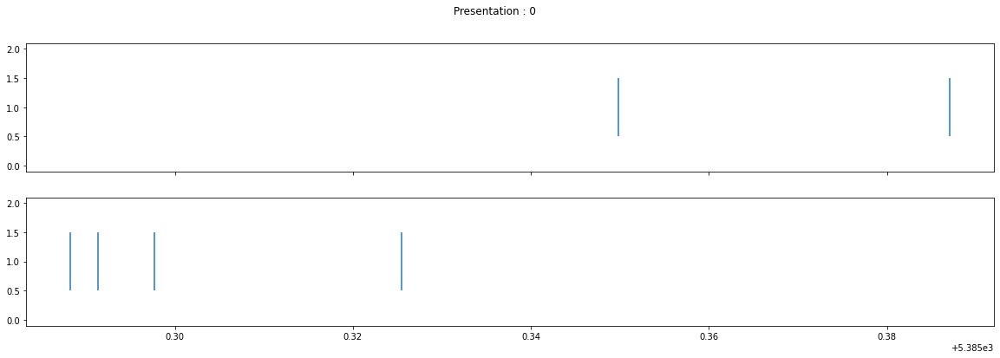

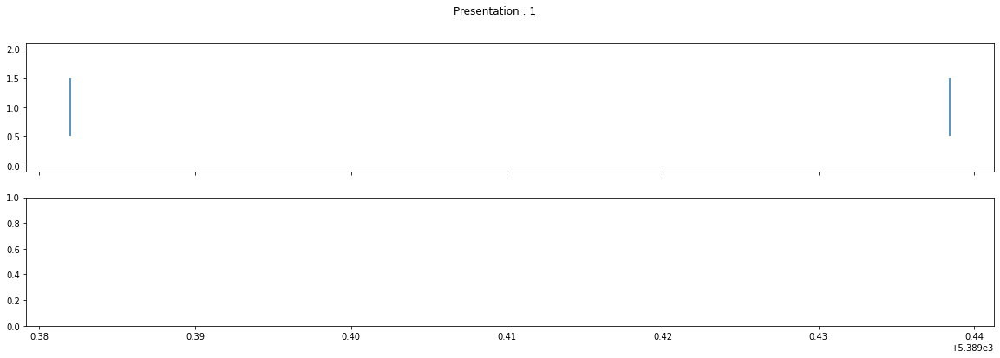

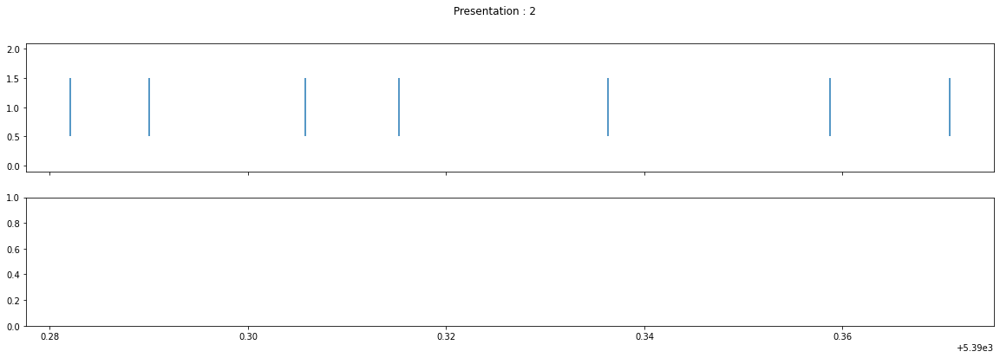

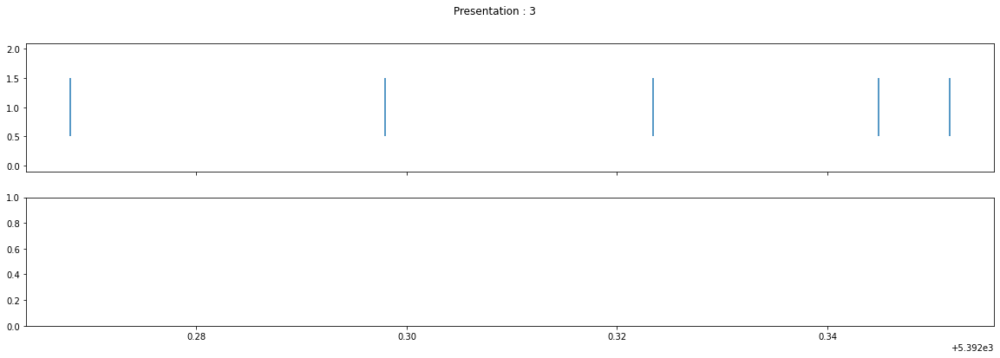

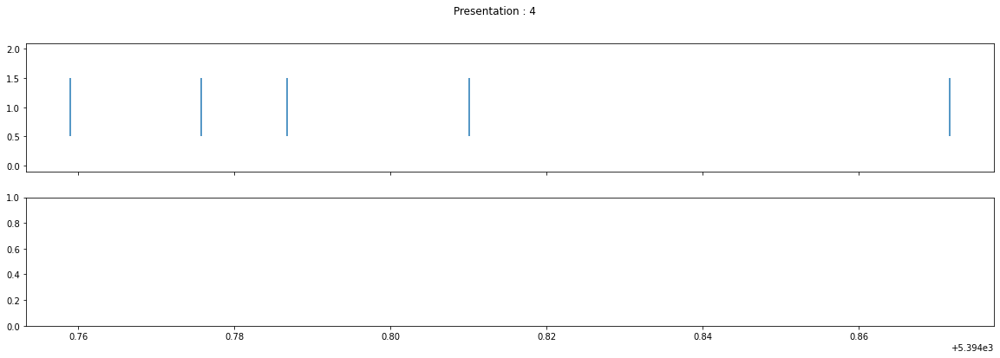

...

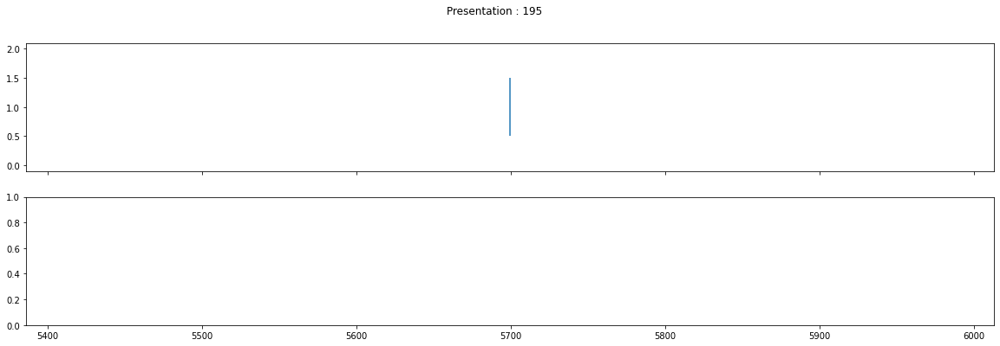

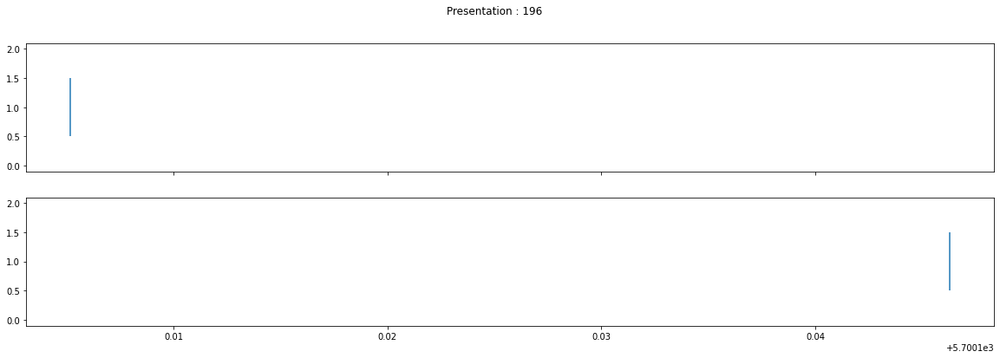

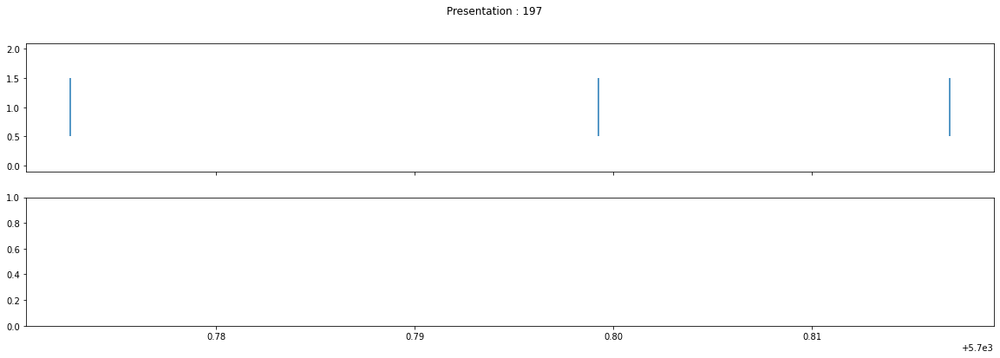

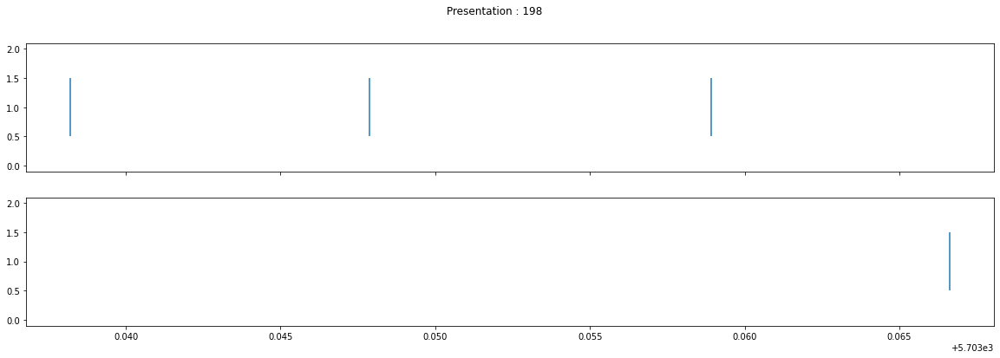

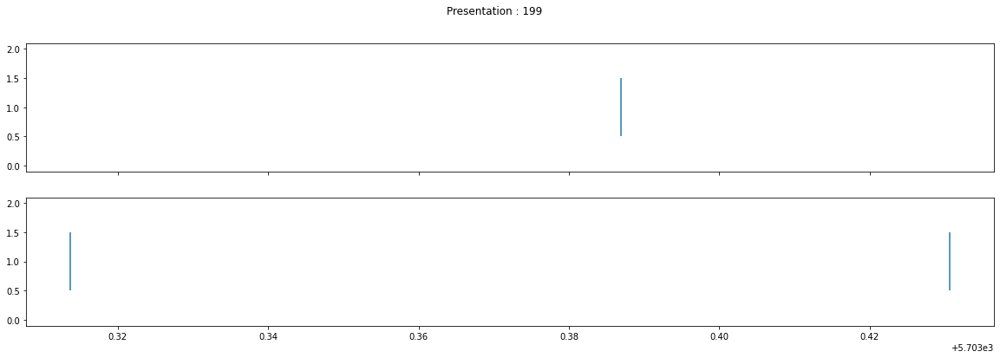

In [ ]:
for i in range(0,200):
  try:
    times_5 = session.presentationwise_spike_times(stimulus_presentation_ids=static_grating_stimulus[static_grating_stimulus['orientation']==0].index.values[i],unit_ids = Visual_cortex_units.index.values[5])
    times_6 = session.presentationwise_spike_times(stimulus_presentation_ids=static_grating_stimulus[static_grating_stimulus['orientation']==0].index.values[i],unit_ids = Visual_cortex_units.index.values[6])

  except:
    pass
fig,axes = plt.subplots(2,1,figsize=(20,6),sharex=True)
    #plt.setp(axes, xlim=(0.5,1))
fig.suptitle('Presentation : '+str(i))
axes[0].eventplot(times_5.index.values)
axes[1].eventplot(times_6.index.values)
#axes.set_xlim(0.6,0.8)
#fig = raster_plot(times_3)
#fig = raster_plot(times_4)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


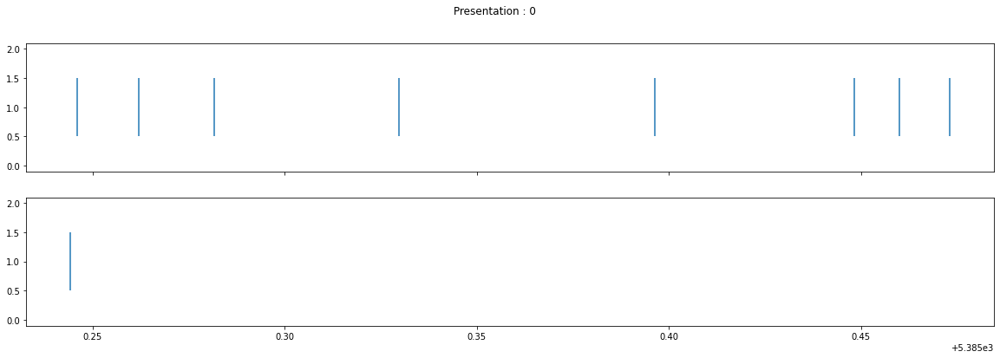

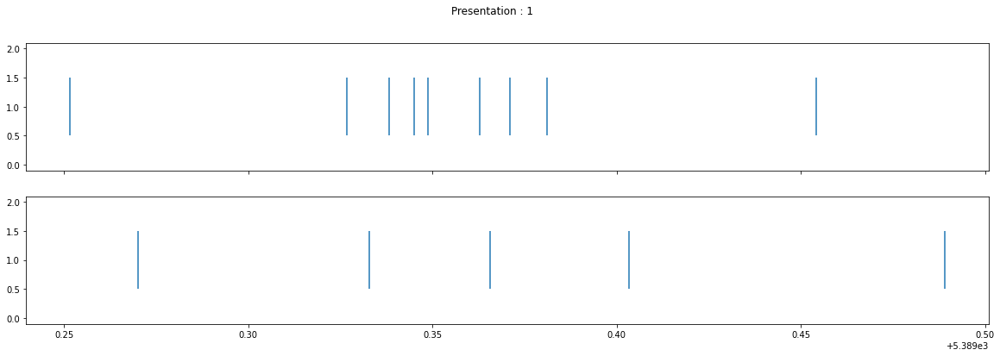

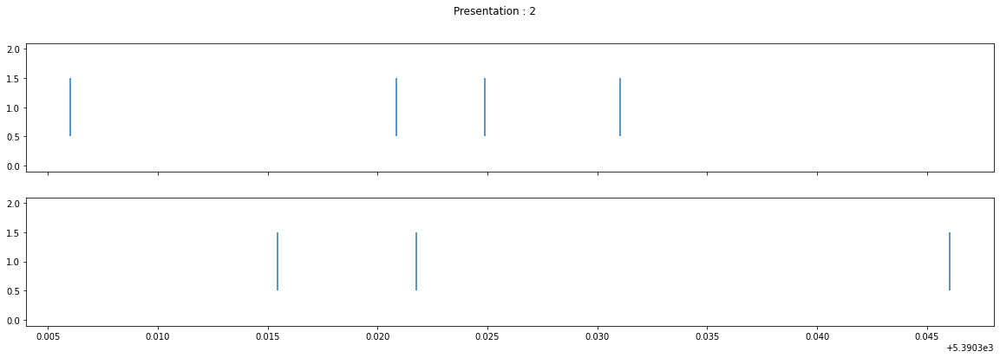

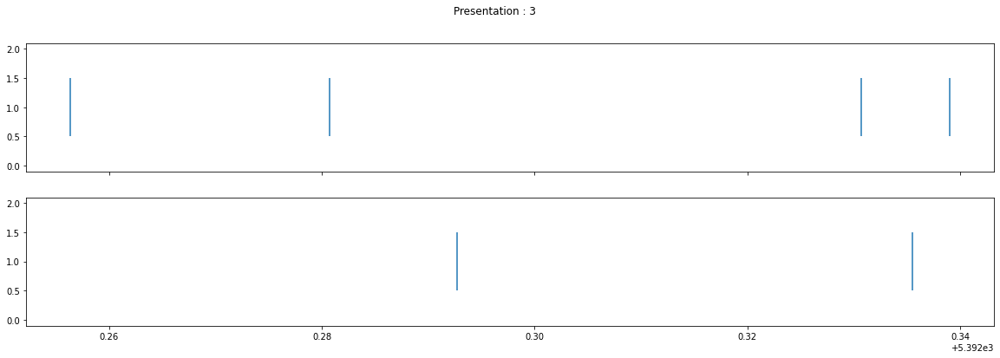

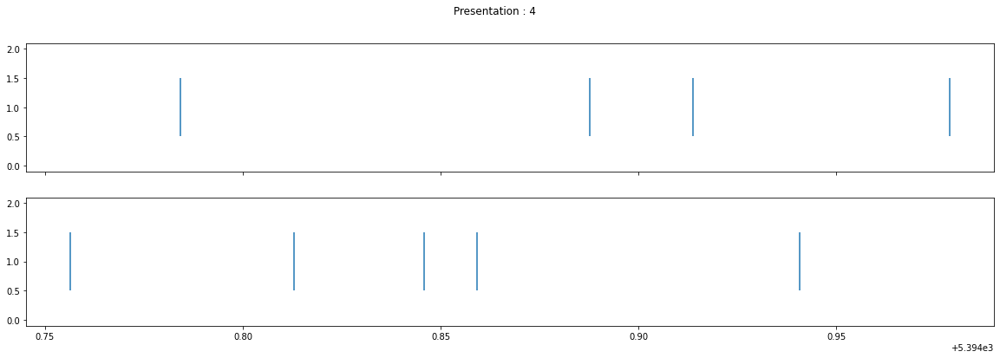

...

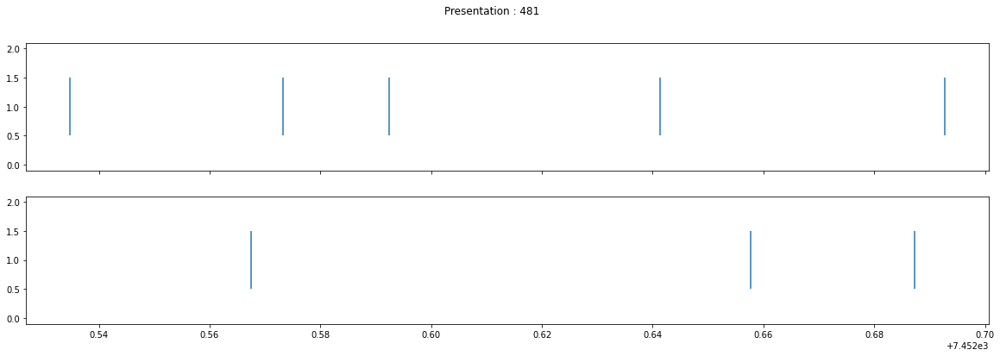

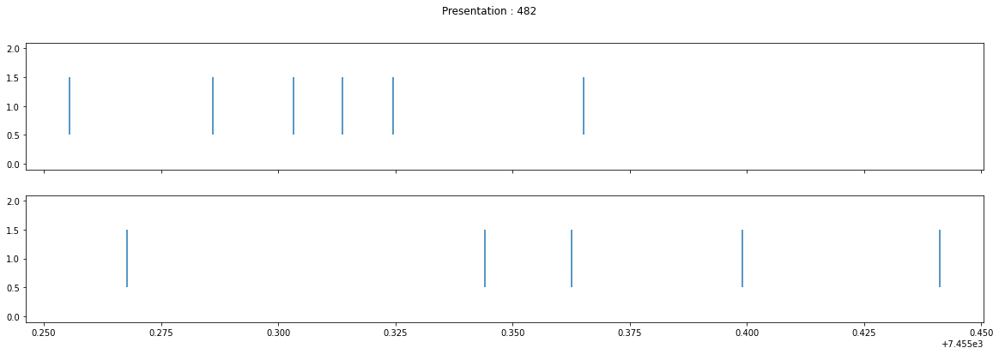

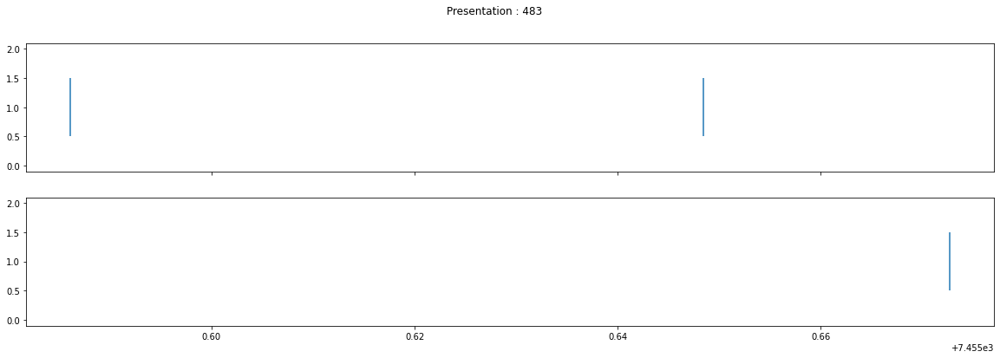

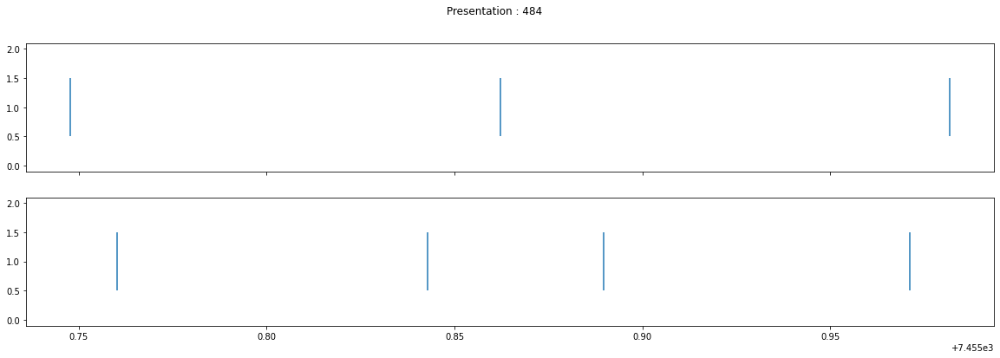

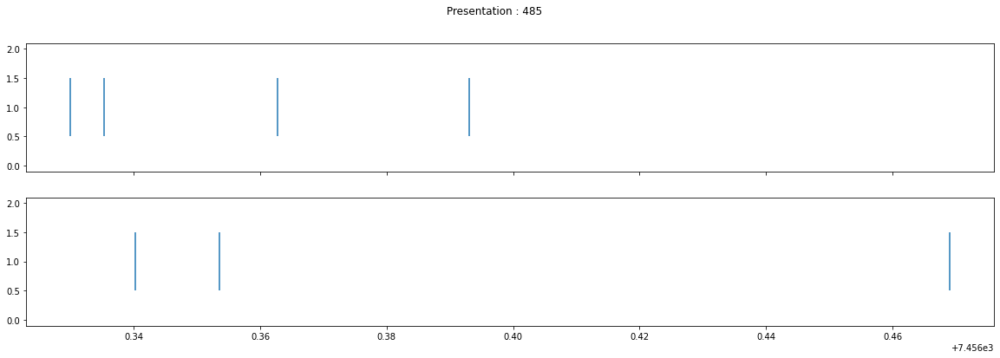

Error in callback <function flush_figures at 0x7f37518ca3b0> (for post_execute):


KeyboardInterrupt: ignored

In [ ]:
for i in range(len(static_grating_stimulus[static_grating_stimulus['orientation']==0])):
  try:
    times_3 = session.presentationwise_spike_times(stimulus_presentation_ids=static_grating_stimulus[static_grating_stimulus['orientation']==0].index.values[i],unit_ids = unit_8)
    times_4 = session.presentationwise_spike_times(stimulus_presentation_ids=static_grating_stimulus[static_grating_stimulus['orientation']==0].index.values[i],unit_ids = unit_9)
    fig,axes = plt.subplots(2,1,figsize=(20,6),sharex=True)
    #plt.setp(axes, xlim=(0.5,1))
    fig.suptitle('Presentation : '+str(i))
    axes[0].eventplot(times_3.index.values)
    axes[1].eventplot(times_4.index.values)
  except:
    pass

#axes.set_xlim(0.6,0.8)
#fig = raster_plot(times_3)
#fig = raster_plot(times_4)


## Gabors

In [ ]:
gabors_stimulus.head()

,contrast,orientation,phase,size,spatial_frequency,start_time,stimulus_block,stimulus_name,stop_time,temporal_frequency,x_position,y_position,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,,,,
1,0.8,45.0,"[3644.93333333, 3644.93333333]","[20.0, 20.0]",0.08,73.537433,0.0,gabors,73.770952,4.0,0.0,30.0,0.233519,1
2,0.8,0.0,"[3644.93333333, 3644.93333333]","[20.0, 20.0]",0.08,73.770952,0.0,gabors,74.021150,4.0,-30.0,-10.0,0.250199,2
3,0.8,45.0,"[3644.93333333, 3644.93333333]","[20.0, 20.0]",0.08,74.021150,0.0,gabors,74.271349,4.0,10.0,20.0,0.250199,3
4,0.8,0.0,"[3644.93333333, 3644.93333333]","[20.0, 20.0]",0.08,74.271349,0.0,gabors,74.521547,4.0,-40.0,-40.0,0.250199,4
5,0.8,90.0,"[3644.93333333, 3644.93333333]","[20.0, 20.0]",0.08,74.521547,0.0,gabors,74.771764,4.0,-10.0,-10.0,0.250216,5


In [ ]:
gabors_stimulus['orientation'].value_counts()

45.0    1215
0.0     1215
90.0    1215
Name: orientation, dtype: int64

In [ ]:
mean_duration_gabors = gabors_stimulus['duration'].mean()
mean_duration_gabors

0.25020442206320465

In [ ]:
session.presen

### 0 degree

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(2, 3), (4, 5), (5, 6), (6, 7), (10, 11), (12, 13), (15, 16), (17, 18), (21, 22), (22, 23), (25, 26), (26, 27), (28, 29), (31, 32), (32, 33), (33, 34), (34, 35), (40, 41), (49, 50), (53, 54), (56, 57), (58, 59), (62, 63), (63, 64), (68, 69), (69, 70), (73, 74), (76, 77), (82, 83), (87, 88), (88, 89), (91, 92), (102, 103), (106, 107), (107, 108), (109, 110), (113, 114), (114, 115), (117, 118), (118, 119), (120, 121), (122, 123), (126, 127), (130, 131), (133, 134), (138, 139), (139, 140), (142, 143), (156, 157), (160, 161), (161, 162), (164, 165), (166, 167), (169, 170), (170, 171), (171, 172), (175, 176), (179, 180), (181, 182), (182, 183), (191, 192), (195, 196), (196, 197), (197, 198), (198, 199), (199, 200), (201, 202), (204, 205), (205, 206), (211, 212), (213, 214), (214, 215), (215, 216), (219, 220

Top 5 units are  [42, 12, 4, 1, 38]


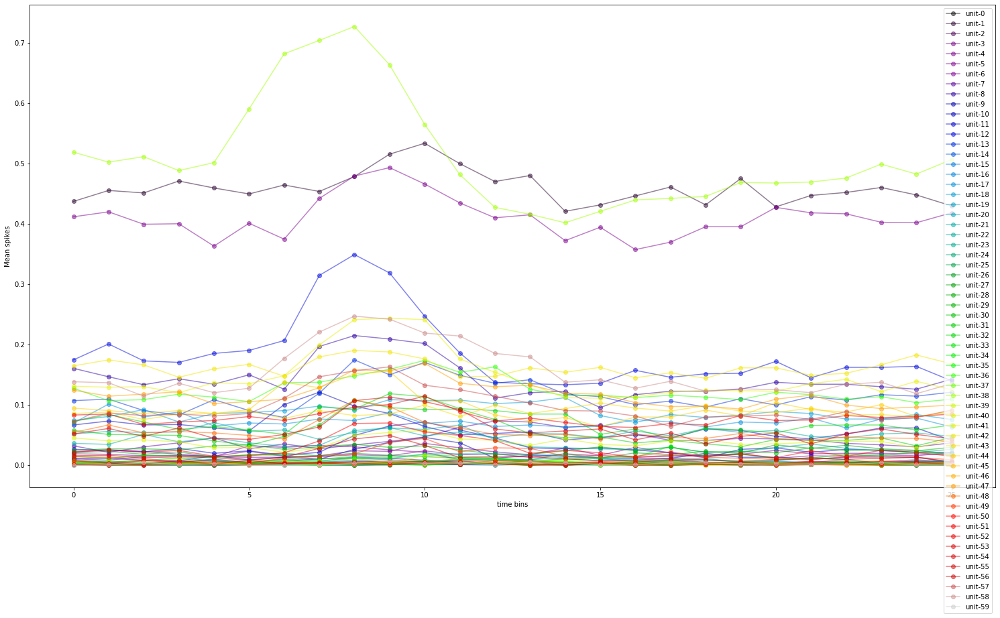

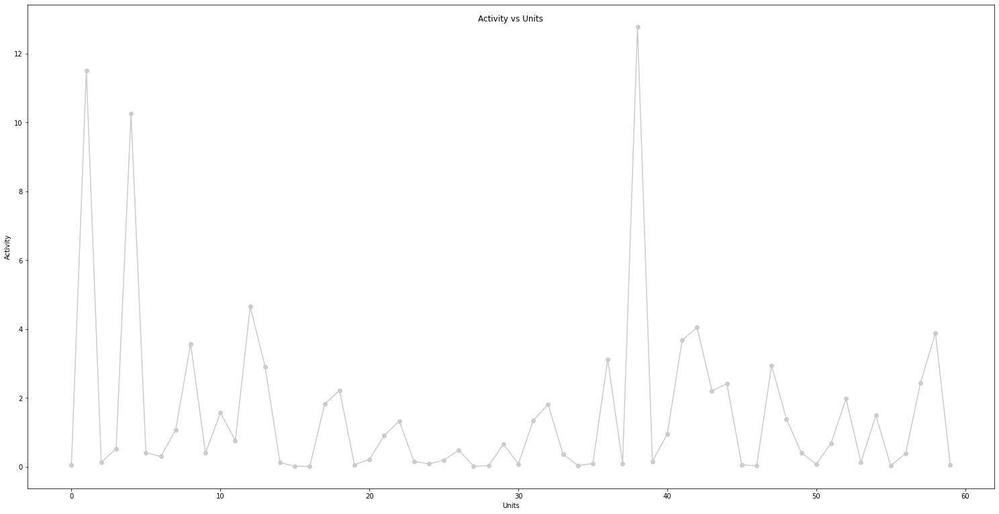

In [ ]:
plot_binned_spike_trains(gabors_stimulus[gabors_stimulus['orientation']==0].index.values,Visual_cortex_units.index.values,0.01 , mean_duration_gabors)

In [ ]:
_plot_binned_spike_trains(gabors_stimulus[gabors_stimulus['orientation']==0].index.values,all_units.index.values,0.01 , mean_duration_gabors)

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(2, 3), (4, 5), (5, 6), (6, 7), (10, 11), (12, 13), (15, 16), (17, 18), (21, 22), (22, 23), (25, 26), (26, 27), (28, 29), (31, 32), (32, 33), (33, 34), (34, 35), (40, 41), (49, 50), (53, 54), (56, 57), (58, 59), (62, 63), (63, 64), (68, 69), (69, 70), (73, 74), (76, 77), (82, 83), (87, 88), (88, 89), (91, 92), (102, 103), (106, 107), (107, 108), (109, 110), (113, 114), (114, 115), (117, 118), (118, 119), (120, 121), (122, 123), (126, 127), (130, 131), (133, 134), (138, 139), (139, 140), (142, 143), (156, 157), (160, 161), (161, 162), (164, 165), (166, 167), (169, 170), (170, 171), (171, 172), (175, 176), (179, 180), (181, 182), (182, 183), (191, 192), (195, 196), (196, 197), (197, 198), (198, 199), (199, 200), (201, 202), (204, 205), (205, 206), (211, 212), (213, 214), (214, 215), (215, 216), (219, 220

Top 5 units are  [71, 38, 64, 526, 500]
spike counts  =  [12.45 13.29 14.14 15.75 19.51]


### 45 degree

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(4, 5), (5, 6), (13, 14), (15, 16), (16, 17), (22, 23), (24, 25), (32, 33), (35, 36), (39, 40), (41, 42), (42, 43), (43, 44), (45, 46), (46, 47), (54, 55), (56, 57), (58, 59), (60, 61), (67, 68), (68, 69), (69, 70), (70, 71), (75, 76), (77, 78), (82, 83), (87, 88), (88, 89), (90, 91), (94, 95), (97, 98), (101, 102), (102, 103), (104, 105), (105, 106), (107, 108), (109, 110), (110, 111), (111, 112), (113, 114), (115, 116), (117, 118), (118, 119), (119, 120), (121, 122), (123, 124), (125, 126), (126, 127), (127, 128), (136, 137), (139, 140), (143, 144), (145, 146), (151, 152), (156, 157), (158, 159), (160, 161), (161, 162), (165, 166), (170, 171), (172, 173), (174, 175), (180, 181), (181, 182), (182, 183), (184, 185), (186, 187), (202, 203), (204, 205), (208, 209), (209, 210), (212, 213), (219, 220), (22

Top 5 units are  [42, 12, 4, 1, 38]


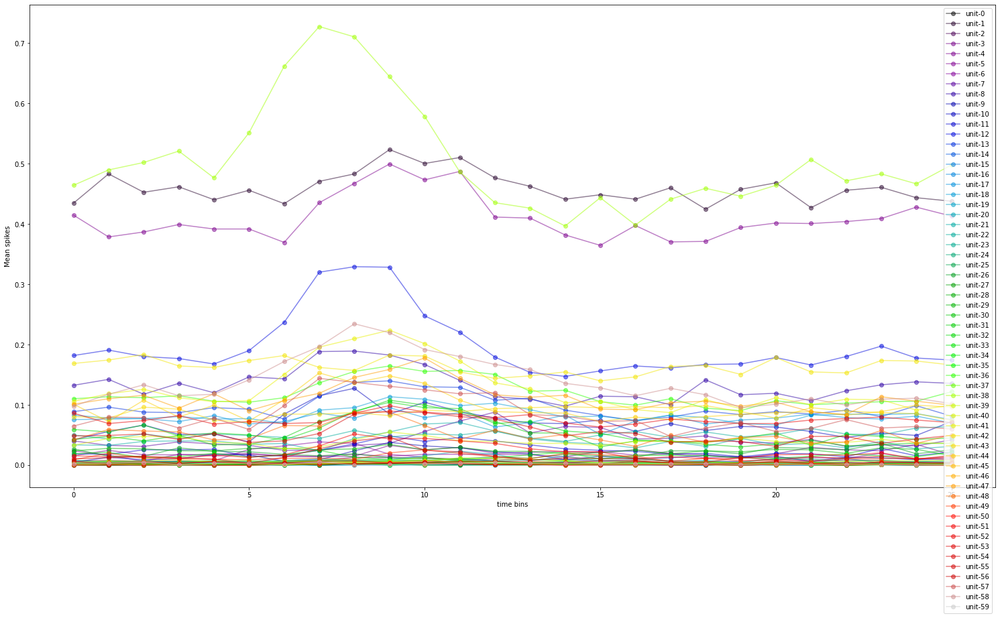

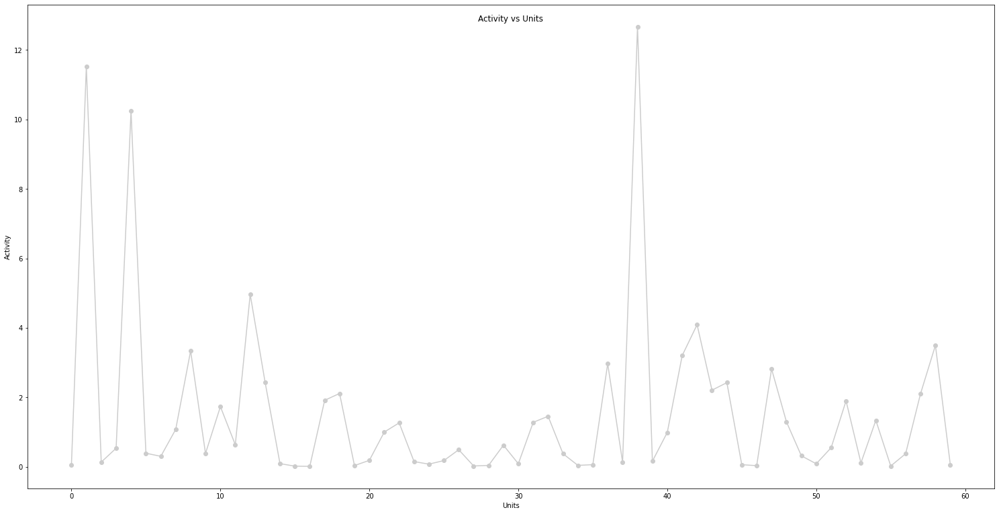

In [ ]:
plot_binned_spike_trains(gabors_stimulus[gabors_stimulus['orientation']==45].index.values,Visual_cortex_units.index.values,0.01 , mean_duration_gabors)

In [ ]:
_plot_binned_spike_trains(gabors_stimulus[gabors_stimulus['orientation']==45].index.values,all_units.index.values,0.1 , mean_duration_gabors)

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(4, 5), (5, 6), (13, 14), (15, 16), (16, 17), (22, 23), (24, 25), (32, 33), (35, 36), (39, 40), (41, 42), (42, 43), (43, 44), (45, 46), (46, 47), (54, 55), (56, 57), (58, 59), (60, 61), (67, 68), (68, 69), (69, 70), (70, 71), (75, 76), (77, 78), (82, 83), (87, 88), (88, 89), (90, 91), (94, 95), (97, 98), (101, 102), (102, 103), (104, 105), (105, 106), (107, 108), (109, 110), (110, 111), (111, 112), (113, 114), (115, 116), (117, 118), (118, 119), (119, 120), (121, 122), (123, 124), (125, 126), (126, 127), (127, 128), (136, 137), (139, 140), (143, 144), (145, 146), (151, 152), (156, 157), (158, 159), (160, 161), (161, 162), (165, 166), (170, 171), (172, 173), (174, 175), (180, 181), (181, 182), (182, 183), (184, 185), (186, 187), (202, 203), (204, 205), (208, 209), (209, 210), (212, 213), (219, 220), (22

Top 5 units are  [71, 38, 64, 526, 500]
spike counts  =  [14.51 15.14 16.24 18.28 22.58]


### 90 degree

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(0, 1), (4, 5), (5, 6), (8, 9), (9, 10), (12, 13), (15, 16), (16, 17), (18, 19), (19, 20), (20, 21), (23, 24), (25, 26), (30, 31), (37, 38), (44, 45), (47, 48), (51, 52), (52, 53), (53, 54), (56, 57), (57, 58), (58, 59), (60, 61), (64, 65), (66, 67), (67, 68), (77, 78), (79, 80), (80, 81), (81, 82), (92, 93), (94, 95), (95, 96), (96, 97), (99, 100), (103, 104), (109, 110), (116, 117), (125, 126), (126, 127), (128, 129), (131, 132), (136, 137), (137, 138), (138, 139), (153, 154), (154, 155), (155, 156), (159, 160), (161, 162), (164, 165), (165, 166), (166, 167), (167, 168), (169, 170), (175, 176), (176, 177), (177, 178), (179, 180), (181, 182), (188, 189), (190, 191), (195, 196), (196, 197), (205, 206), (207, 208), (214, 215), (216, 217), (218, 219), (219, 220), (220, 221), (221, 222), (223, 224), (224,

Top 5 units are  [42, 12, 4, 1, 38]


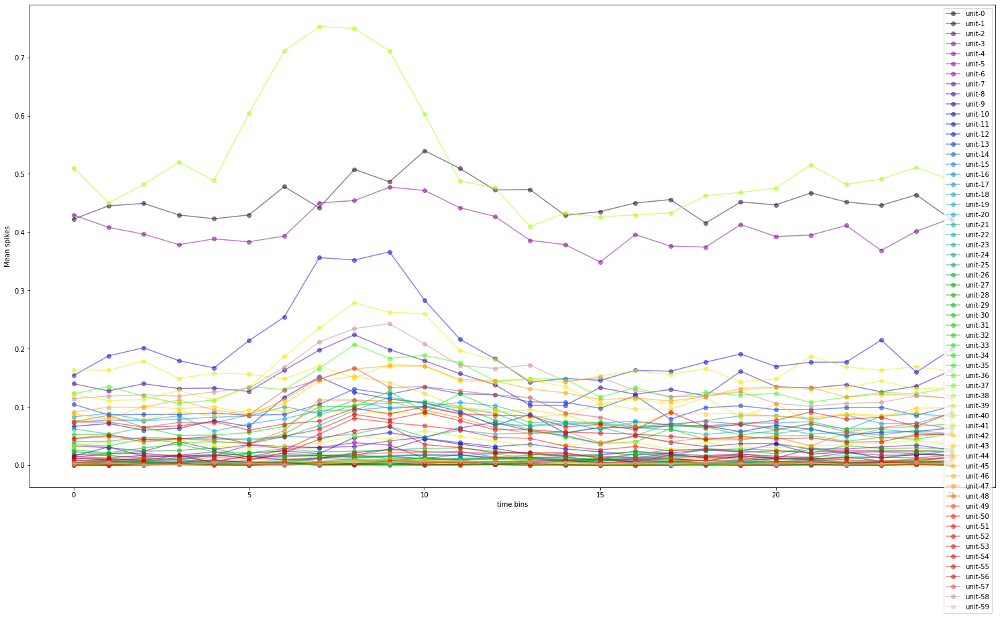

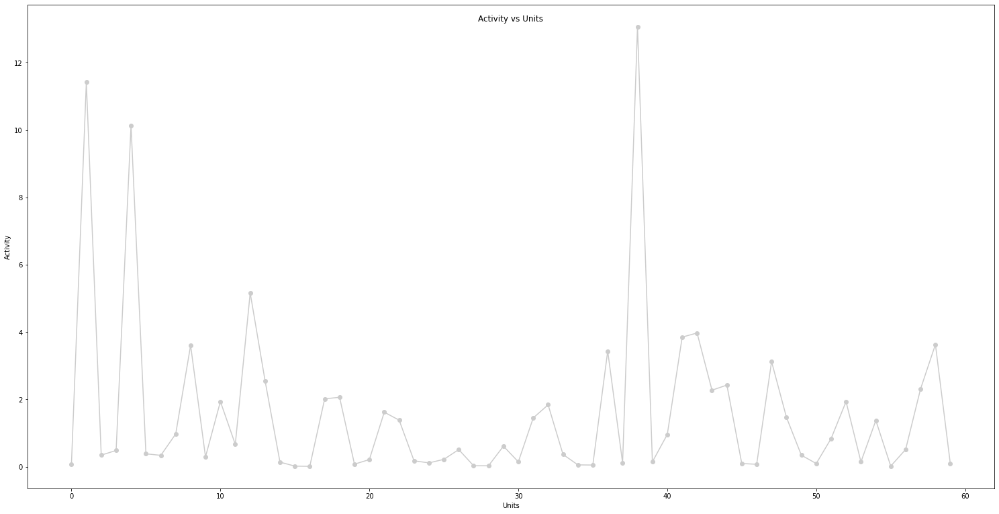

In [ ]:
plot_binned_spike_trains(gabors_stimulus[gabors_stimulus['orientation']==90].index.values,Visual_cortex_units.index.values,0.01 , mean_duration_gabors)

## Natural Scenes

In [ ]:
natural_scenes_stimulus.head()

,frame,start_time,stimulus_block,stimulus_name,stop_time,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,
51353,5.0,5892.415053,9.0,natural_scenes,5892.665249,0.250196,4908
51354,114.0,5892.665249,9.0,natural_scenes,5892.915445,0.250196,4909
51355,13.0,5892.915445,9.0,natural_scenes,5893.165641,0.250196,4910
51356,70.0,5893.165641,9.0,natural_scenes,5893.415837,0.250196,4911
51357,26.0,5893.415837,9.0,natural_scenes,5893.666049,0.250211,4912


In [ ]:
mean_duration_natural_scenes = natural_scenes_stimulus['duration'].mean()
mean_duration_natural_scenes

0.25021178525718574

In [ ]:
natural_scenes_stimulus['frame'].value_counts()

5.0     50
34.0    50
39.0    50
22.0    50
21.0    50
        ..
55.0    50
38.0    50
95.0    50
73.0    50
4.0     50
Name: frame, Length: 119, dtype: int64

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9), (9, 10), (10, 11), (11, 12), (12, 13), (13, 14), (14, 15), (15, 16), (16, 17), (17, 18), (18, 19), (19, 20), (20, 21), (21, 22), (22, 23), (23, 24), (24, 25), (25, 26), (26, 27), (27, 28), (28, 29), (29, 30), (30, 31), (31, 32), (32, 33), (33, 34), (34, 35), (35, 36), (36, 37), (37, 38), (38, 39), (39, 40), (40, 41), (41, 42), (42, 43), (43, 44), (44, 45), (45, 46), (46, 47), (47, 48), (48, 49), (49, 50), (50, 51), (51, 52), (52, 53), (53, 54), (54, 55), (55, 56), (56, 57), (57, 58), (58, 59), (59, 60), (60, 61), (61, 62), (62, 63), (63, 64), (64, 65), (65, 66), (66, 67), (67, 68), (68, 69), (69, 70), (70, 71), (71, 72), (72, 73), (73, 74), (74, 75), (75, 76), (76, 77), (77, 78), (78, 79), (79, 80), (80, 81), (81, 82), (82, 83), (8

Top 5 units are  [41, 58, 4, 1, 38]


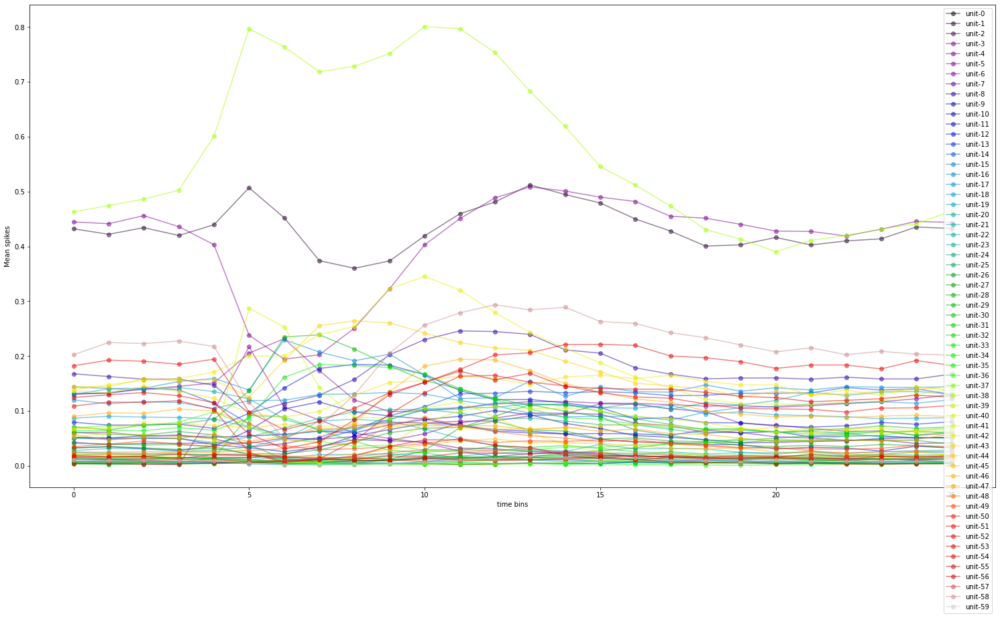

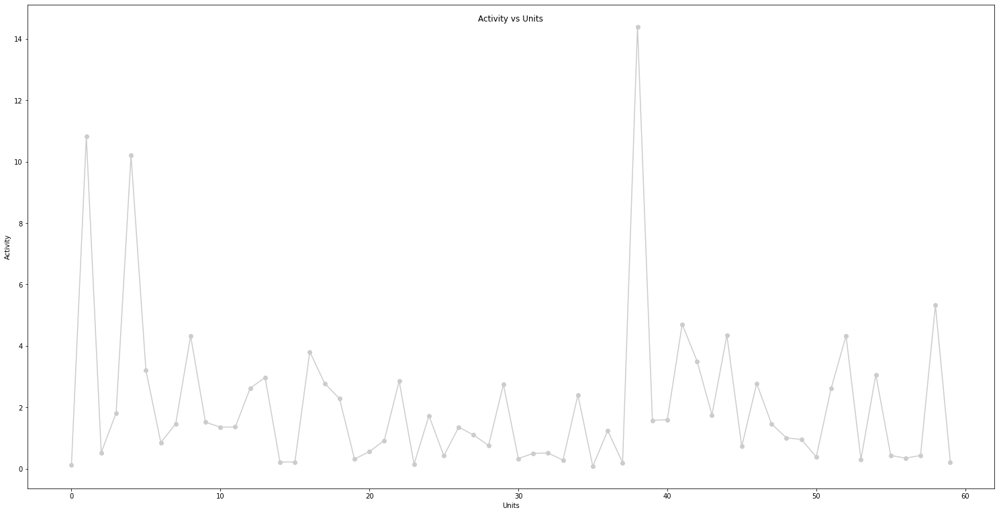

In [ ]:
plot_binned_spike_trains(natural_scenes_stimulus.index.values,Visual_cortex_units.index.values,0.01 , mean_duration_natural_scenes)

## Drifiting Grating

In [ ]:
drifting_gratings_stimulus.head()

,contrast,orientation,phase,size,spatial_frequency,start_time,stimulus_block,stimulus_name,stop_time,temporal_frequency,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,,
3798,0.8,315.0,"[21211.93333333, 21211.93333333]","[250.0, 250.0]",0.04,1574.774823,2.0,drifting_gratings,1576.776513,4.0,2.00169,246
3799,0.8,90.0,"[21211.93333333, 21211.93333333]","[250.0, 250.0]",0.04,1577.777347,2.0,drifting_gratings,1579.779027,8.0,2.00168,247
3800,0.8,225.0,"[21211.93333333, 21211.93333333]","[250.0, 250.0]",0.04,1580.779833,2.0,drifting_gratings,1582.781563,2.0,2.00173,248
3801,0.8,90.0,"[21211.93333333, 21211.93333333]","[250.0, 250.0]",0.04,1583.782367,2.0,drifting_gratings,1585.784047,2.0,2.00168,249
3802,0.8,135.0,"[21211.93333333, 21211.93333333]","[250.0, 250.0]",0.04,1586.784883,2.0,drifting_gratings,1588.786553,8.0,2.00167,250


In [ ]:
mean_duration_drifting = drifting_gratings_stimulus['duration'].mean()

In [ ]:
len(drifting_gratings_stimulus)

628

In [ ]:
drifting_gratings_stimulus['orientation'].value_counts()

315.0    75
90.0     75
225.0    75
270.0    75
180.0    75
45.0     75
135.0    74
0.0      74
null     30
Name: orientation, dtype: int64

### 0 degree 

Top 5 units are  [13, 12, 4, 38, 1]


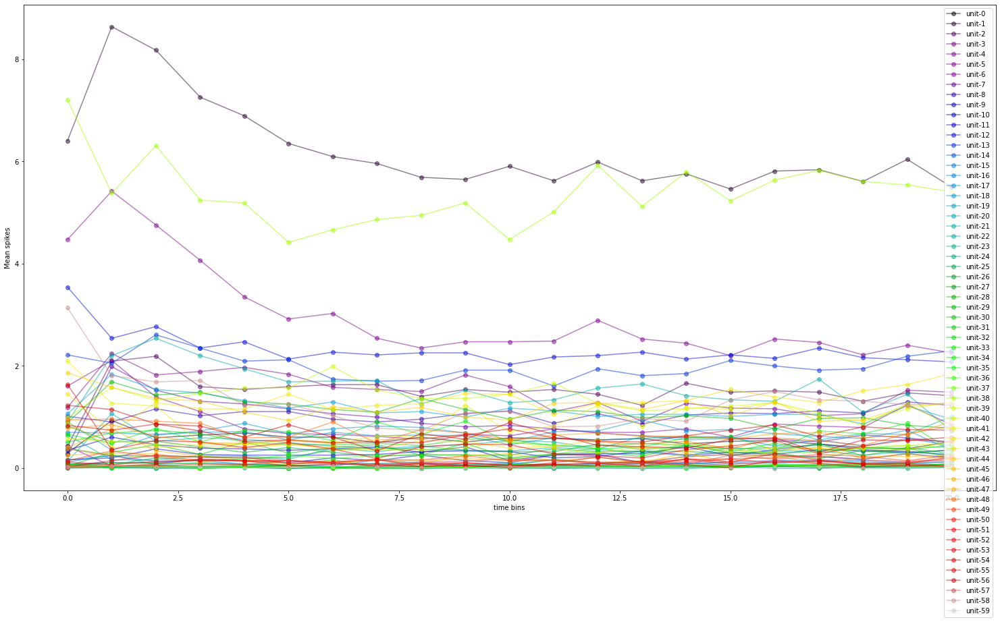

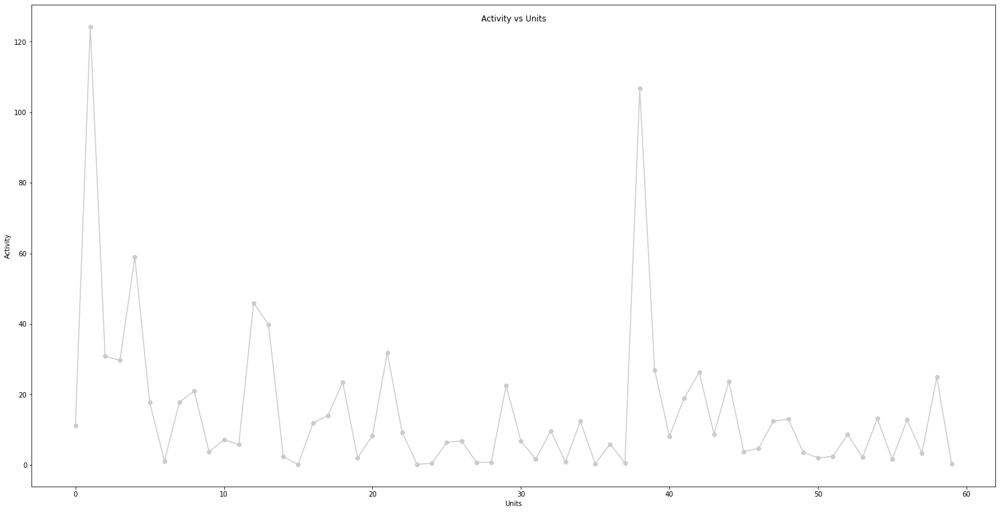

In [ ]:
plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==0].index.values,Visual_cortex_units.index.values,0.1 , mean_duration_drifting)

In [ ]:
_plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==0].index.values,all_units.index.values,0.1 , mean_duration_drifting)


Top 5 units are  [792, 1, 526, 500, 842]
spike counts  =  [115.84 130.26 143.18 143.88 159.27]


### 45 degree

Top 5 units are  [12, 2, 4, 38, 1]


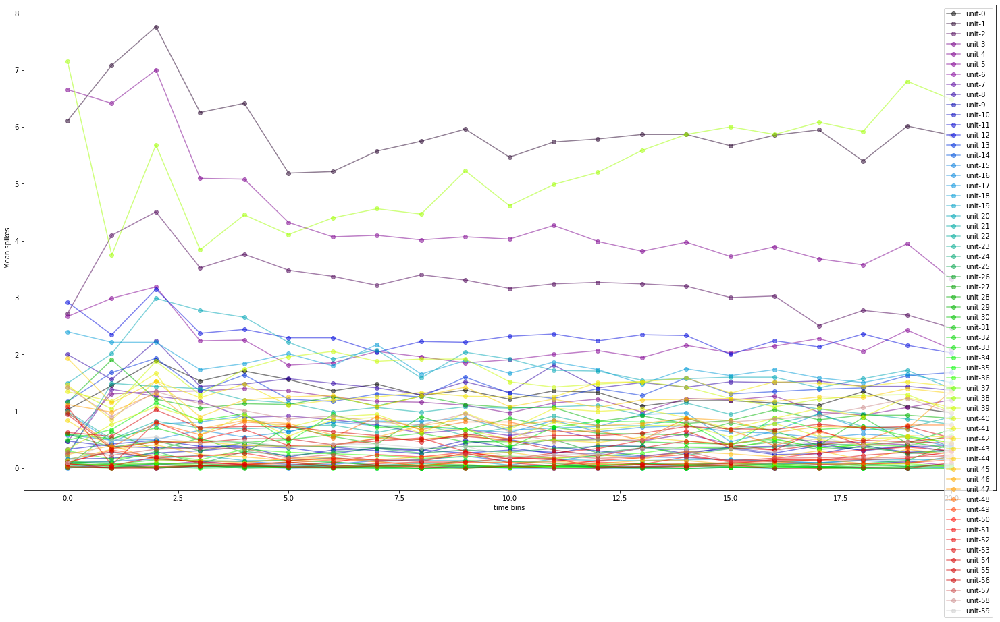

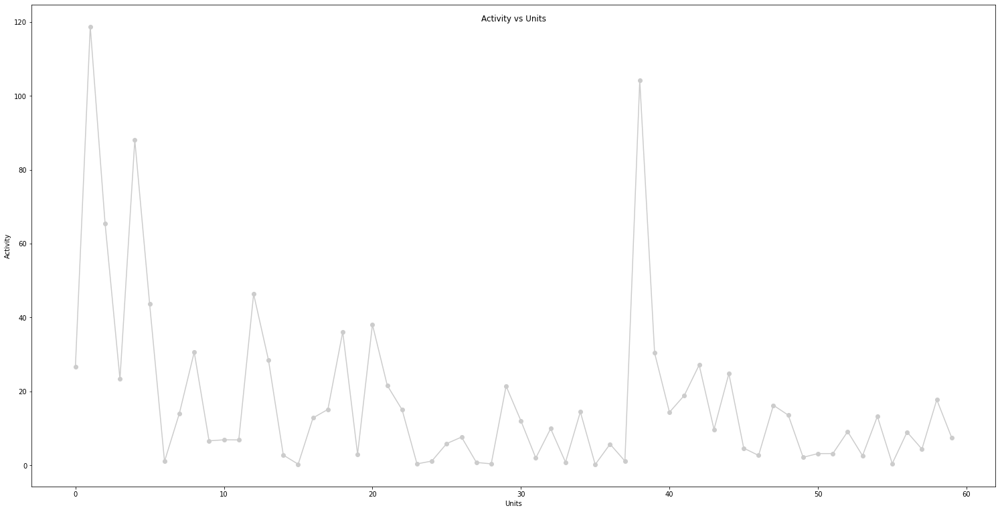

In [ ]:
plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==45].index.values,Visual_cortex_units.index.values,0.1 , mean_duration_drifting)

In [ ]:
_plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==45].index.values,all_units.index.values,0.1 , mean_duration_drifting)


Top 5 units are  [1, 71, 526, 500, 842]
spike counts  =  [124.75 146.52 149.08 164.23 211.  ]


### 90 degree

Top 5 units are  [5, 29, 4, 38, 1]


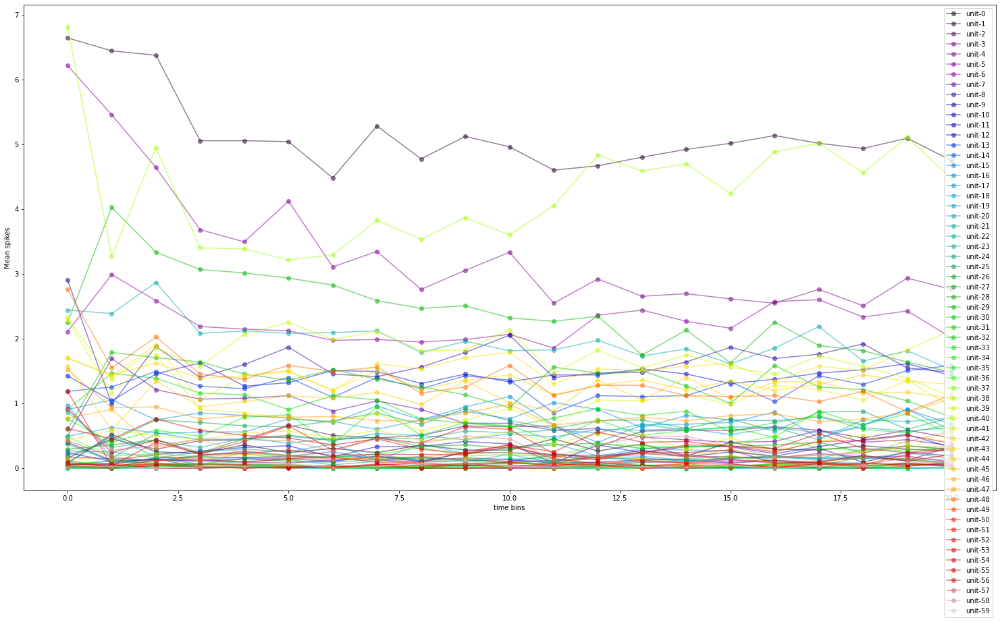

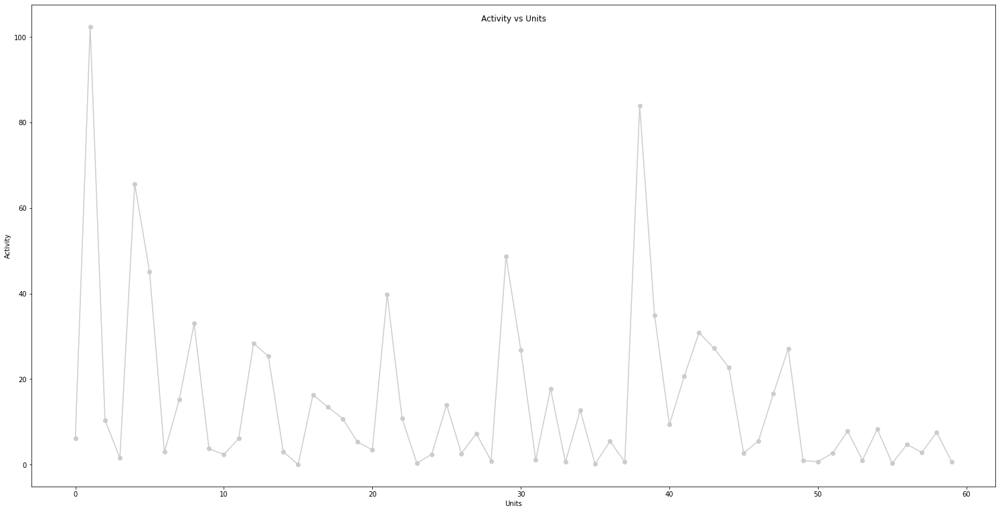

In [ ]:
plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==90].index.values,Visual_cortex_units.index.values,0.1 , mean_duration_drifting)

In [ ]:
_plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==90].index.values,all_units.index.values,0.1 , mean_duration_drifting)


Top 5 units are  [523, 500, 526, 842, 71]
spike counts  =  [111.2  155.85 155.87 157.96 183.97]


### 135 degree

Top 5 units are  [12, 29, 5, 1, 38]


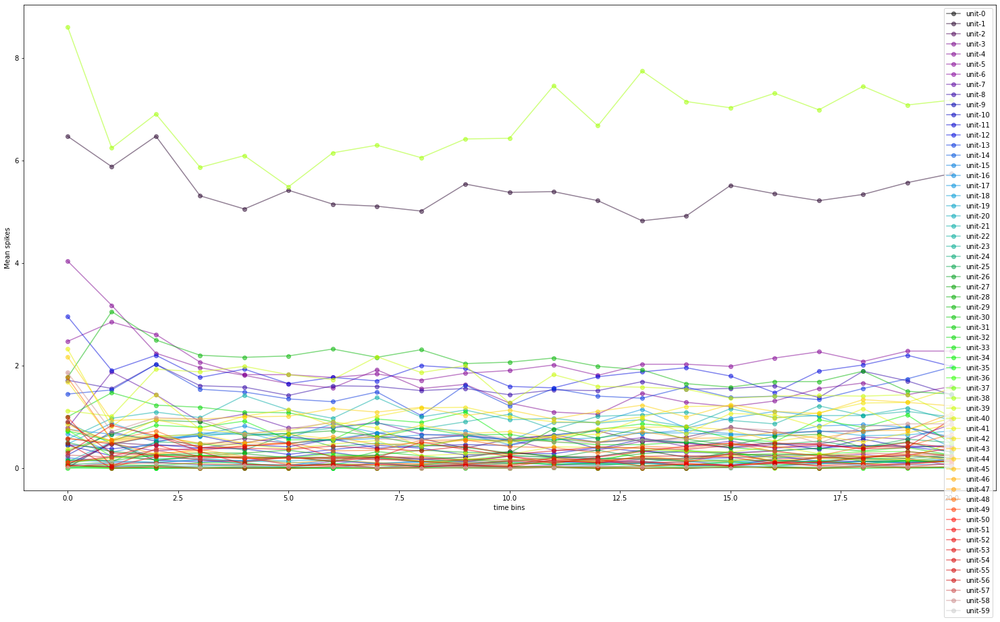

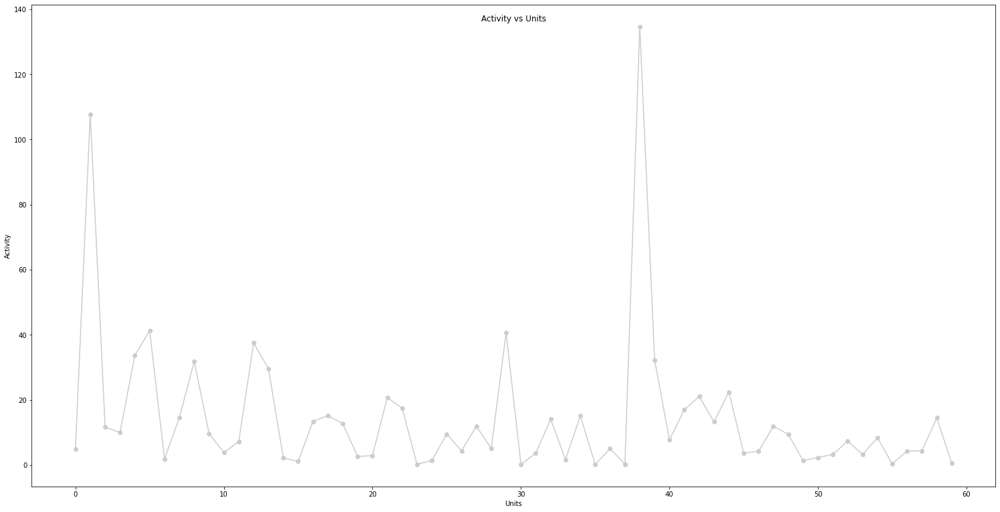

In [ ]:
plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==135].index.values,Visual_cortex_units.index.values,0.1 , mean_duration_drifting)

In [ ]:
_plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==135].index.values,all_units.index.values,0.1 , mean_duration_drifting)


Top 5 units are  [526, 842, 38, 71, 500]
spike counts  =  [141.27 142.24 142.61 158.3  160.97]


### 180 degree

Top 5 units are  [13, 12, 4, 38, 1]


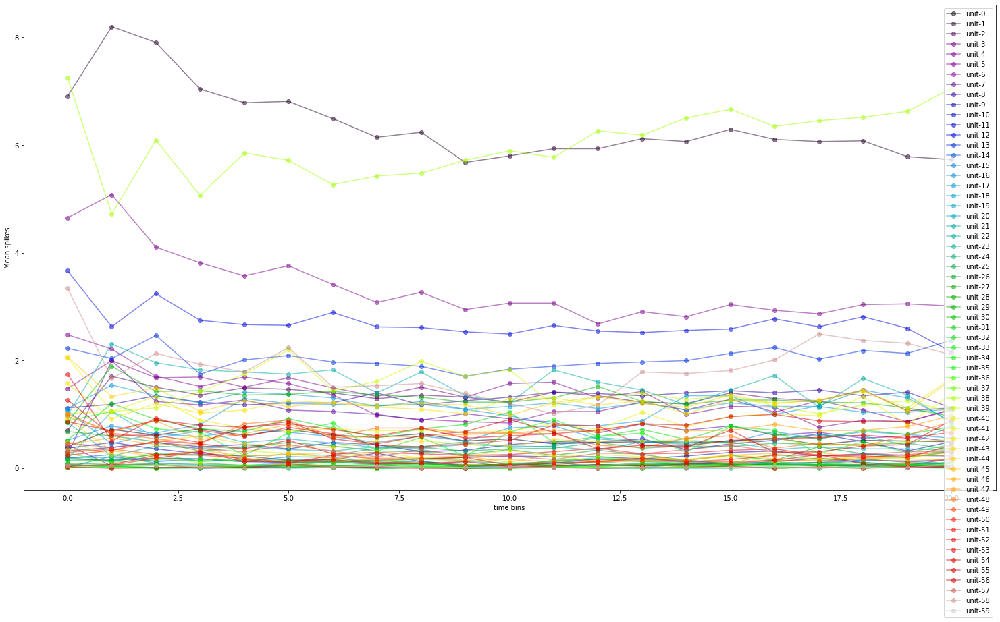

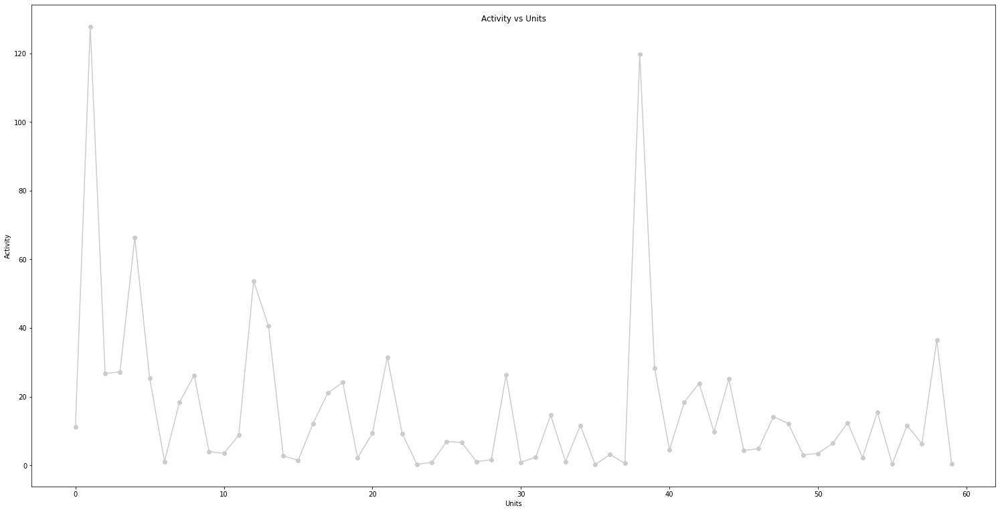

In [ ]:
plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==180].index.values,Visual_cortex_units.index.values,0.1 , mean_duration_drifting)

In [ ]:
_plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==180].index.values,all_units.index.values,0.1 , mean_duration_drifting)


Top 5 units are  [38, 1, 842, 526, 500]
spike counts  =  [126.89 134.13 151.8  155.61 159.52]


### 225 degree

Top 5 units are  [12, 2, 4, 38, 1]


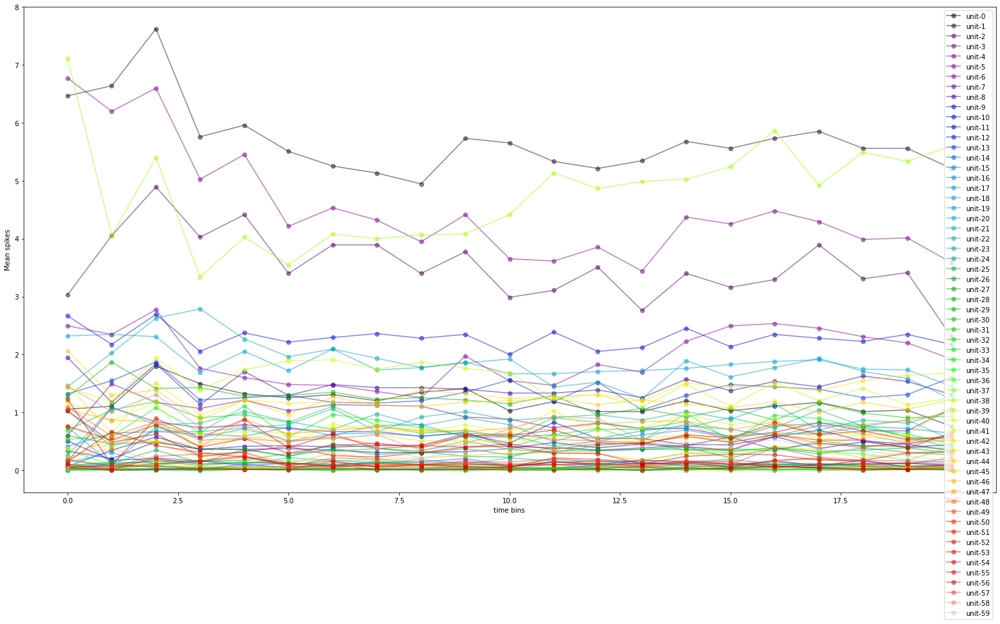

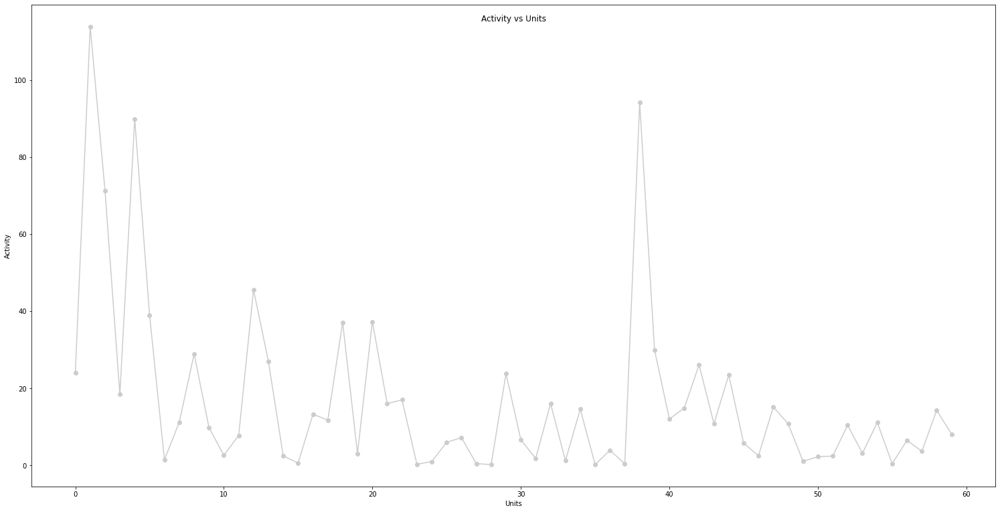

In [ ]:
plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==225].index.values,Visual_cortex_units.index.values,0.1 , mean_duration_drifting)

In [ ]:
_plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==225].index.values,all_units.index.values,0.1 , mean_duration_drifting)


Top 5 units are  [1, 71, 526, 500, 842]
spike counts  =  [119.73 137.67 150.41 152.56 209.32]


### 270 degree

Top 5 units are  [5, 29, 4, 38, 1]


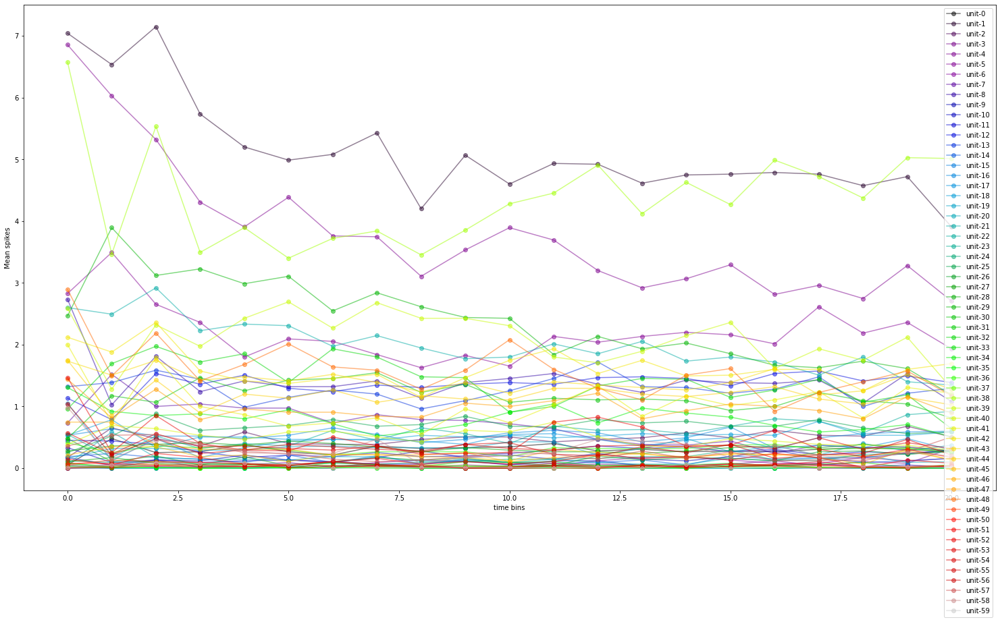

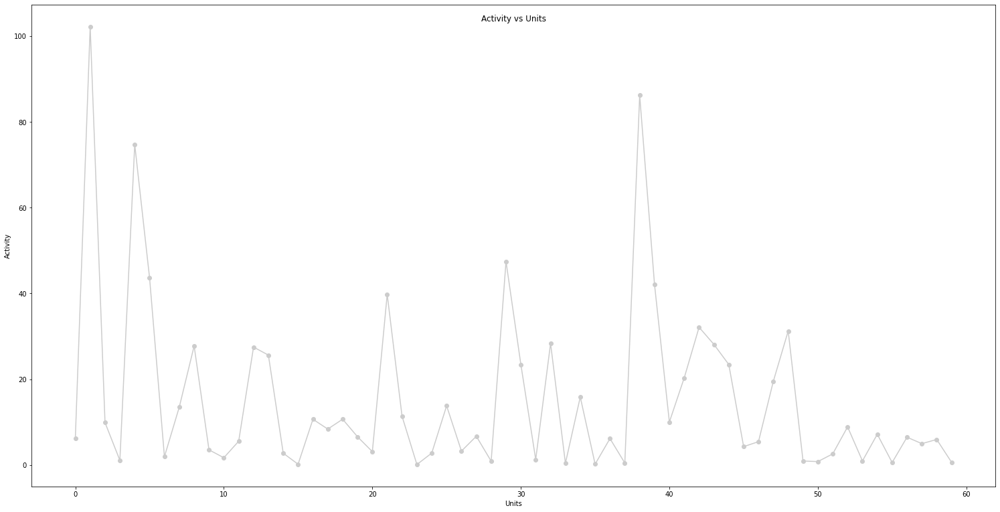

In [ ]:
plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==270].index.values,Visual_cortex_units.index.values,0.1 , mean_duration_drifting)

### 315 degree

Top 5 units are  [4, 5, 12, 1, 38]


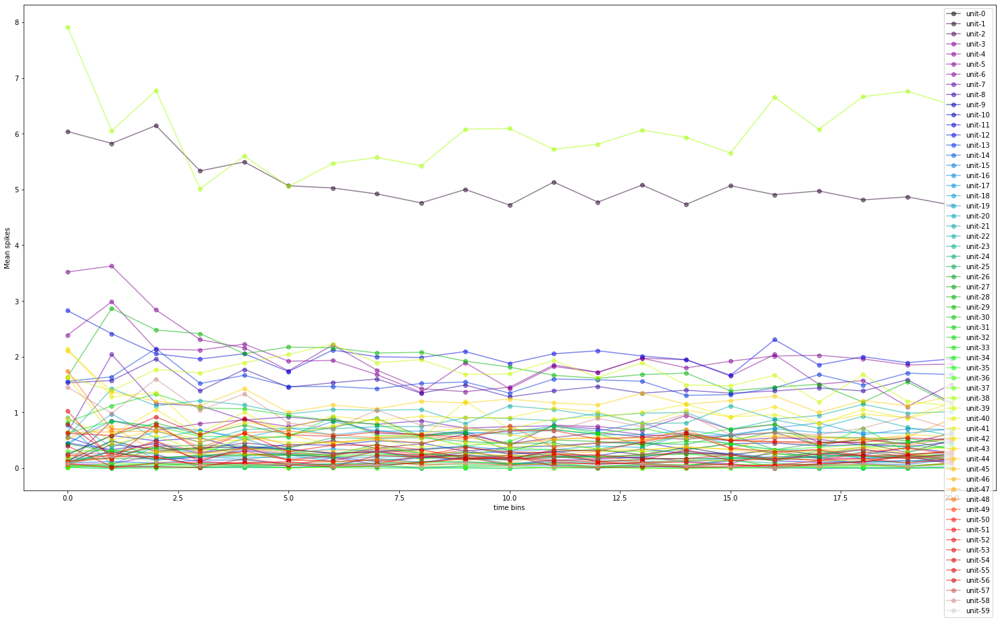

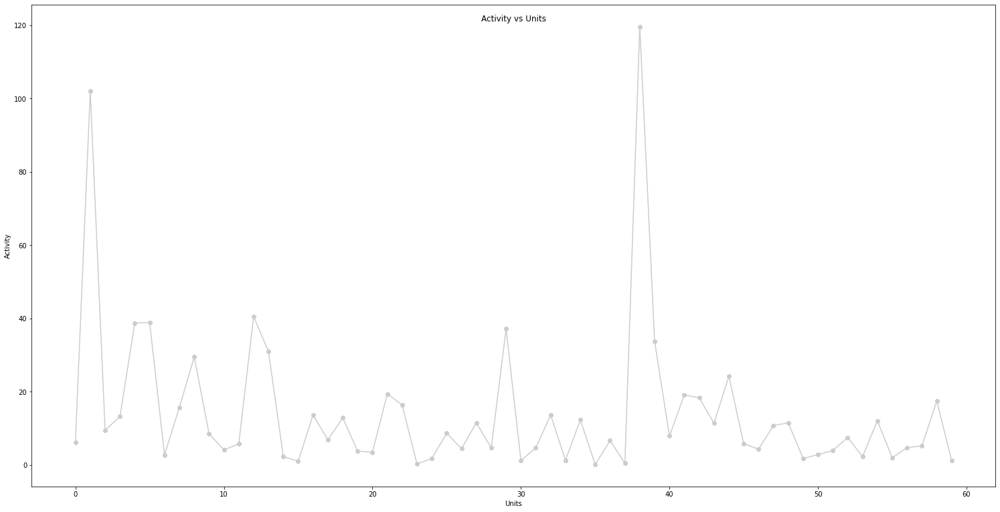

In [ ]:
plot_binned_spike_trains(drifting_gratings_stimulus[drifting_gratings_stimulus['orientation']==315].index.values,Visual_cortex_units.index.values,0.1 , mean_duration_drifting)

##Flashes



In [ ]:
flashes_stimulus.head()

,color,contrast,orientation,phase,size,spatial_frequency,start_time,stimulus_block,stimulus_name,stop_time,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,,
3647,-1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1274.523973,1.0,flashes,1274.774189,0.250216,244
3648,-1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1276.525623,1.0,flashes,1276.775842,0.250219,244
3649,1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1278.527343,1.0,flashes,1278.777552,0.250209,245
3650,-1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1280.529013,1.0,flashes,1280.779222,0.250209,244
3651,1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1282.530723,1.0,flashes,1282.780924,0.250201,245


In [ ]:
mean_duration_flashes = flashes_stimulus['duration'].mean(axis=0)

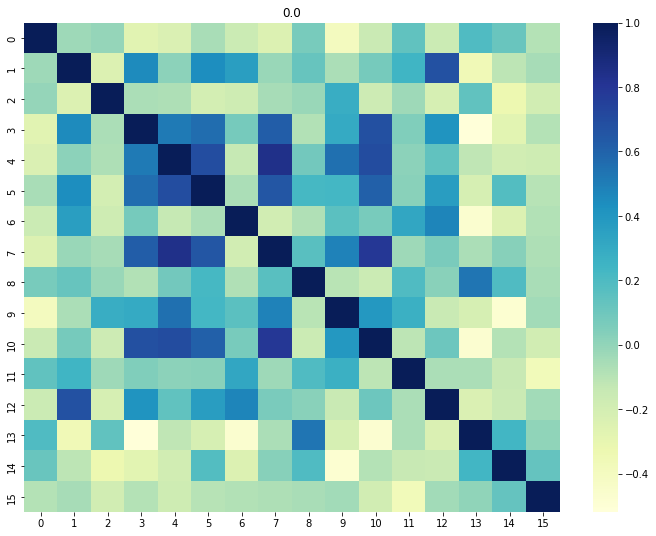

In [ ]:
sorted_dataframe(flashes_stimulus)

In [ ]:
flashes_stimulus['orientation'].value_counts()

0.0    150
Name: orientation, dtype: int64

### 0 degree Orientation

Top 5 units are  [8, 12, 4, 1, 38]


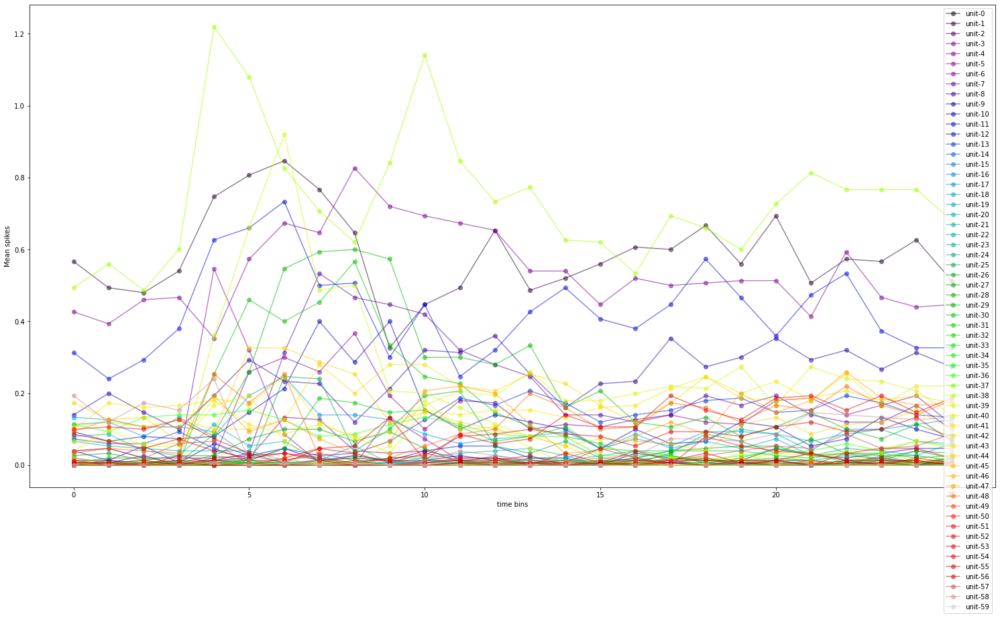

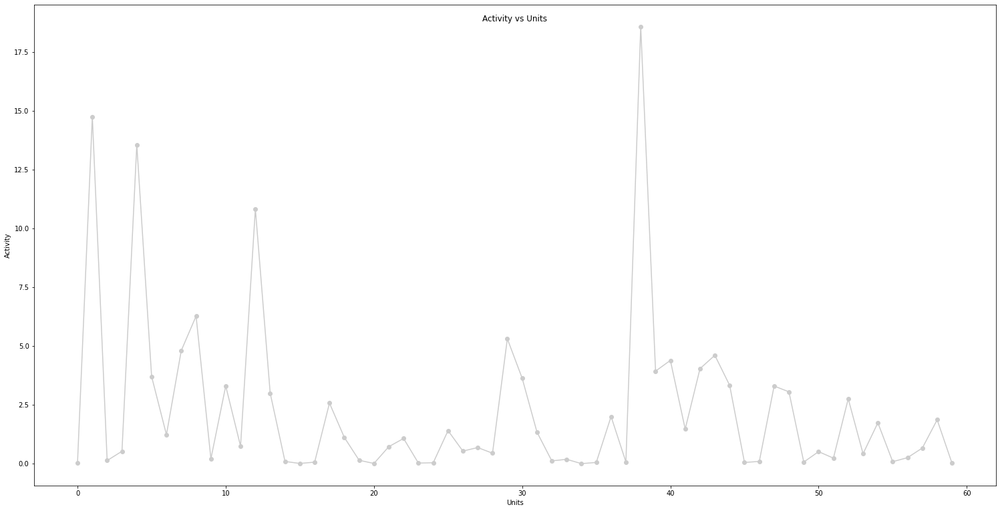

In [ ]:
plot_binned_spike_trains(flashes_stimulus[flashes_stimulus['orientation']==0].index.values,Visual_cortex_units.index.values,0.01 , mean_duration_flashes)

## Natural Movie one

In [ ]:
natural_movie_one.head()

,contrast,frame,orientation,size,start_time,stimulus_block,stimulus_name,stop_time,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,
22000,1.0,0.0,0.0,"[1920.0, 1080.0]",2835.861733,4.0,natural_movie_one,2835.895094,0.033361,3887
22001,1.0,1.0,0.0,"[1920.0, 1080.0]",2835.895094,4.0,natural_movie_one,2835.928455,0.033361,3888
22002,1.0,2.0,0.0,"[1920.0, 1080.0]",2835.928455,4.0,natural_movie_one,2835.961816,0.033361,3889
22003,1.0,3.0,0.0,"[1920.0, 1080.0]",2835.961816,4.0,natural_movie_one,2835.995178,0.033361,3890
22004,1.0,4.0,0.0,"[1920.0, 1080.0]",2835.995178,4.0,natural_movie_one,2836.028539,0.033361,3891


In [ ]:
mean_duration_natural_movie_one = natural_movie_one['duration'].mean()
mean_duration_natural_movie_one

0.03336120055555555

Top 5 units are  [58, 12, 4, 1, 38]


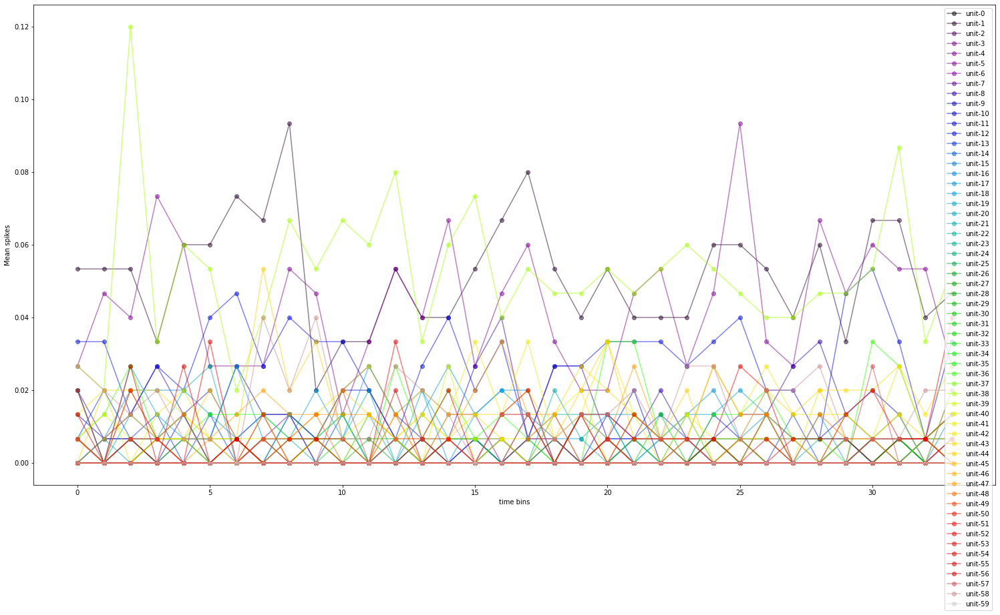

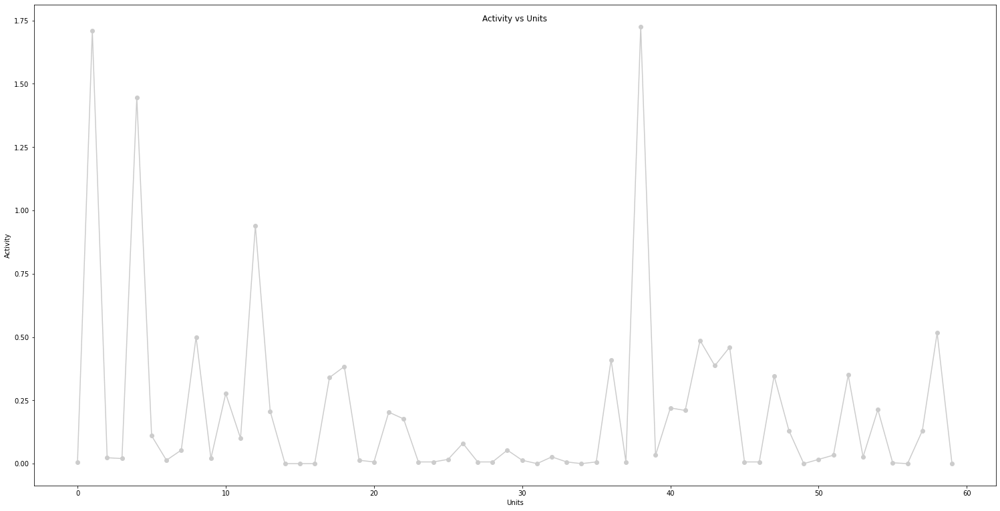

In [ ]:
plot_binned_spike_trains(flashes_stimulus[flashes_stimulus['orientation']==0].index.values,Visual_cortex_units.index.values,0.001 , mean_duration_natural_movie_one)

# Heat map for correlating the Units using spike trains from entire session

In [ ]:
spike_times = {}
no_of_bins = 200
for unit_id in Visual_cortex_units.index.values:
  #binning the time data into 200 bins , value in 1 bin represent no of spikes in that time duration 
  spike_times[unit_id] = binned_statistic(session.spike_times[unit_id],session.spike_times[unit_id],bins=no_of_bins,statistic='count')[0]

In [ ]:
spikes_every_stimulus = pd.DataFrame(spike_times)
spikes_every_stimulus.head()

,950930340,950930407,950930522,950930866,950930985,950930964,950931164,950931423,950931458,950931533,950931581,950931751,950931727,950931899,950931878,950932696
0,1.0,1943.0,41.0,106.0,2657.0,57.0,45.0,143.0,538.0,25.0,62.0,48.0,516.0,119.0,8.0,2.0
1,2.0,1912.0,28.0,174.0,2350.0,71.0,69.0,265.0,604.0,27.0,312.0,85.0,836.0,516.0,3.0,3.0
2,2.0,2232.0,8.0,35.0,2411.0,82.0,56.0,333.0,638.0,44.0,374.0,105.0,836.0,556.0,22.0,1.0
3,42.0,1908.0,8.0,7.0,2058.0,139.0,59.0,239.0,526.0,36.0,200.0,82.0,741.0,506.0,21.0,6.0
4,85.0,2219.0,15.0,2.0,1883.0,89.0,73.0,142.0,622.0,38.0,266.0,108.0,763.0,436.0,67.0,1.0


In [ ]:
stimulus_table.head()

In [ ]:
stimulus_table['stimulus_name'].value_counts()

natural_movie_three    36000
natural_movie_one      18000
static_gratings         6000
natural_scenes          5950
gabors                  3645
drifting_gratings        628
flashes                  150
spontaneous               15
Name: stimulus_name, dtype: int64

Total 6000 presentation for the static gratings stimulus , so we see for every units how much spikes per presentation

In [ ]:
spikes_every_stimulus.corr()

Text(0.5, 1.0, 'Correlation between 16 neurons for stimulus of an entire session')

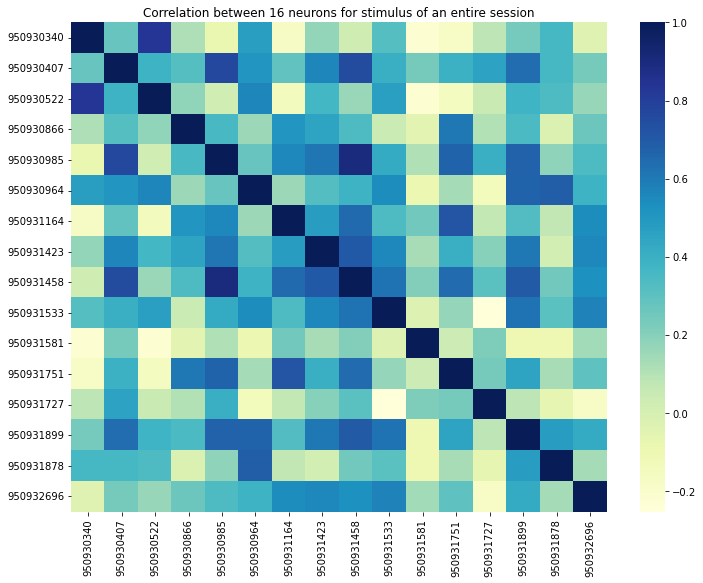

In [ ]:
plt.figure(figsize=(12,9))
sns.heatmap(data =spikes_every_stimulus.corr() ,cmap="YlGnBu")
plt.title('Correlation between 16 neurons for stimulus of an entire session')

# Heat map for mean spike rates for a particular stimulus

The below is for static grating stimulus

In [ ]:
unit_8 = Visual_cortex_units.index.values[8]
unit_9 = Visual_cortex_units.index.values[9]
unit_12 = Visual_cortex_units.index.values[12]

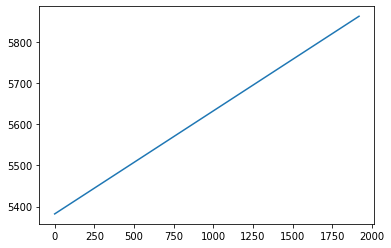

In [ ]:
plt.plot(np.arange(0,len(static_grating_stimulus[static_grating_stimulus['stimulus_block']==8])),static_grating_stimulus[static_grating_stimulus['stimulus_block']==8]['start_time'])

In [ ]:
#data for static grating 
spike_trains_grating = []
for i in range(len(Visual_cortex_units)):
  unit_id = Visual_cortex_units.index.values[i]
  spike_times = session.presentationwise_spike_times(stimulus_presentation_ids=static_grating_stimulus[static_grating_stimulus['stimulus_block']==8].index.values,unit_ids=unit_id)
  spike_trains_grating.append(spike_times.index.values)


In [ ]:
spike_trains_grating[0]

array([5382.11804748, 5382.26831422, 5382.43664764, ..., 5859.54971782,
       5860.98638522, 5862.07101911])

In [ ]:
#data for drifting grating 
spike_trains_drifting_grating = []
for i in range(len(Visual_cortex_units)):
  unit_id = Visual_cortex_units.index.values[i]
  spike_times = session.presentationwise_spike_times(stimulus_presentation_ids=drifting_gratings_stimulus[drifting_gratings_stimulus['stimulus_block']==7].index.values,unit_ids=unit_id)
  spike_trains_drifting_grating.append(spike_times.index.values)


In [ ]:
# data for gabors
spike_trains_gabors = []
for i in range(len(Visual_cortex_units)):
  unit_id = Visual_cortex_units.index.values[i]
  spike_times = session.presentationwise_spike_times(stimulus_presentation_ids=gabors_stimulus[gabors_stimulus['stimulus_block']==0].index.values,unit_ids=unit_id)
  spike_trains_gabors.append(spike_times.index.values)

In [ ]:
fig = plt.figure(figsize=(10,10))
axes = fig.add_axes([0,0,1,1])
axes.plot()

In [ ]:
flashes_stimulus

,color,contrast,orientation,phase,size,spatial_frequency,start_time,stimulus_block,stimulus_name,stop_time,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,,
3647,-1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1274.523973,1.0,flashes,1274.774189,0.250216,244
3648,-1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1276.525623,1.0,flashes,1276.775842,0.250219,244
3649,1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1278.527343,1.0,flashes,1278.777552,0.250209,245
3650,-1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1280.529013,1.0,flashes,1280.779222,0.250209,244
3651,1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1282.530723,1.0,flashes,1282.780924,0.250201,245
...,...,...,...,...,...,...,...,...,...,...,...,...
3792,1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1564.766513,1.0,flashes,1565.016712,0.250199,245
3793,-1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1566.768143,1.0,flashes,1567.018352,0.250209,244
3794,-1.0,0.8,0.0,"[0.0, 0.0]","[300.0, 300.0]","[0.0, 0.0]",1568.769833,1.0,flashes,1569.020042,0.250209,244


In [ ]:
first_drifting_grating_presentation_id = np.unique(spike_times['stimulus_presentation_id'])[0]
plot_times = spike_times[spike_times['stimulus_presentation_id'] == first_drifting_grating_presentation_id]

fig = raster_plot(plot_times, title=f'spike raster for stimulus presentation {first_drifting_grating_presentation_id}')
plt.show()

In [ ]:
from allensdk.brain_observatory.ecephys.visualization import plot_mean_waveforms, plot_spike_counts, raster_plot


Getting data table for different stimulus seperately

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9), (9, 10), (10, 11), (11, 12), (12, 13), (13, 14), (14, 15), (15, 16), (16, 17), (17, 18), (18, 19), (19, 20), (20, 21), (21, 22), (22, 23), (23, 24), (24, 25), (25, 26), (26, 27), (27, 28), (28, 29), (29, 30), (30, 31), (31, 32), (32, 33), (33, 34), (34, 35), (35, 36), (36, 37), (37, 38), (38, 39), (39, 40), (40, 41), (41, 42), (42, 43), (43, 44), (44, 45), (45, 46), (46, 47), (47, 48), (48, 49), (49, 50), (50, 51), (51, 52), (52, 53), (53, 54), (54, 55), (55, 56), (56, 57), (57, 58), (58, 59), (59, 60), (60, 61), (61, 62), (62, 63), (63, 64), (64, 65), (65, 66), (66, 67), (67, 68), (68, 69), (69, 70), (70, 71), (71, 72), (72, 73), (73, 74), (74, 75), (75, 76), (76, 77), (77, 78), (78, 79), (79, 80), (80, 81), (81, 82), (82, 83), (8

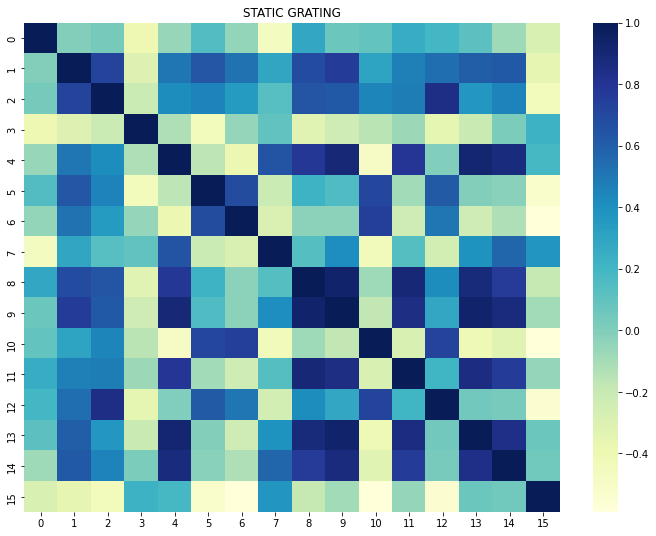

In [ ]:
df = plot_correlated_heatmap(static_grating_stimulus.index.values,Visual_cortex_units.index.values,'STATIC GRATING')


In [ ]:
df.shape

(120, 16)

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9), (9, 10), (10, 11), (11, 12), (12, 13), (13, 14), (14, 15), (15, 16), (16, 17), (17, 18), (18, 19), (19, 20), (20, 21), (21, 22), (22, 23), (23, 24), (24, 25), (25, 26), (26, 27), (27, 28), (28, 29), (29, 30), (30, 31), (31, 32), (32, 33), (33, 34), (34, 35), (35, 36), (36, 37), (37, 38), (38, 39), (39, 40), (40, 41), (41, 42), (42, 43), (43, 44), (44, 45), (45, 46), (46, 47), (47, 48), (48, 49), (49, 50), (50, 51), (51, 52), (52, 53), (53, 54), (54, 55), (55, 56), (56, 57), (57, 58), (58, 59), (59, 60), (60, 61), (61, 62), (62, 63), (63, 64), (64, 65), (65, 66), (66, 67), (67, 68), (68, 69), (69, 70), (70, 71), (71, 72), (72, 73), (73, 74), (74, 75), (75, 76), (76, 77), (77, 78), (78, 79), (79, 80), (80, 81), (81, 82), (82, 83), (8

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,0.0,0.333333,0.066667,0.066667,0.333333,0.066667,0.0,0.066667,0.133333,0.066667,0.000000,0.000000,0.000000,0.133333,0.0,0.0
1,0.0,0.266667,0.000000,0.000000,0.200000,0.200000,0.0,0.066667,0.000000,0.000000,0.000000,0.000000,0.066667,0.066667,0.0,0.0
2,0.0,0.333333,0.000000,0.000000,0.133333,0.066667,0.0,0.000000,0.133333,0.066667,0.000000,0.066667,0.000000,0.133333,0.0,0.0
3,0.0,0.200000,0.000000,0.000000,0.333333,0.200000,0.0,0.000000,0.066667,0.000000,0.000000,0.066667,0.066667,0.066667,0.0,0.0
4,0.0,0.266667,0.000000,0.000000,0.266667,0.066667,0.0,0.000000,0.066667,0.066667,0.066667,0.000000,0.200000,0.066667,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115,0.0,0.133333,0.000000,0.066667,0.200000,0.133333,0.0,0.000000,0.066667,0.066667,0.066667,0.000000,0.066667,0.000000,0.0,0.0
116,0.0,0.200000,0.000000,0.066667,0.200000,0.066667,0.0,0.000000,0.000000,0.000000,0.000000,0.066667,0.200000,0.066667,0.0,0.0
117,0.0,0.133333,0.000000,0.066667,0.066667,0.000000,0.0,0.000000,0.066667,0.000000,0.000000,0.000000,0.200000,0.000000,0.0,0.0
118,0.0,0.200000,0.000000,0.000000,0.200000,0.066667,0.0,0.000000,0.000000,0.066667,0.000000,0.000000,0.066667,0.000000,0.0,0.0


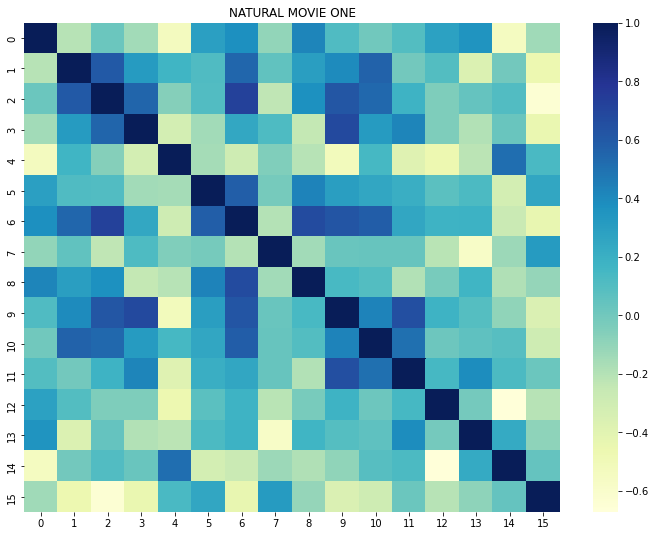

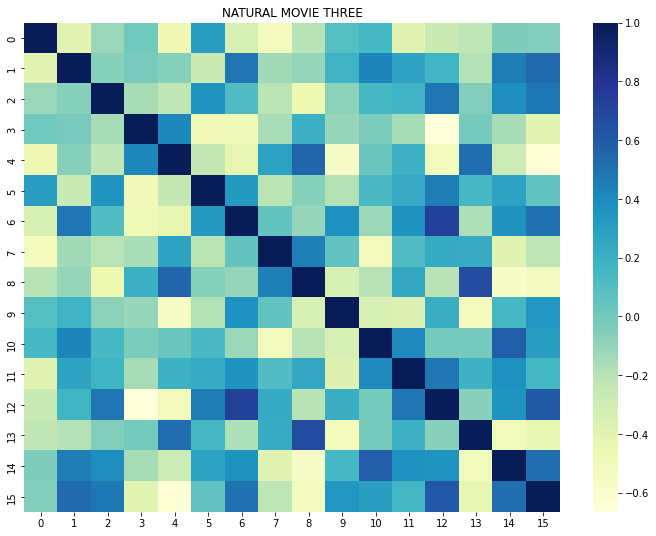

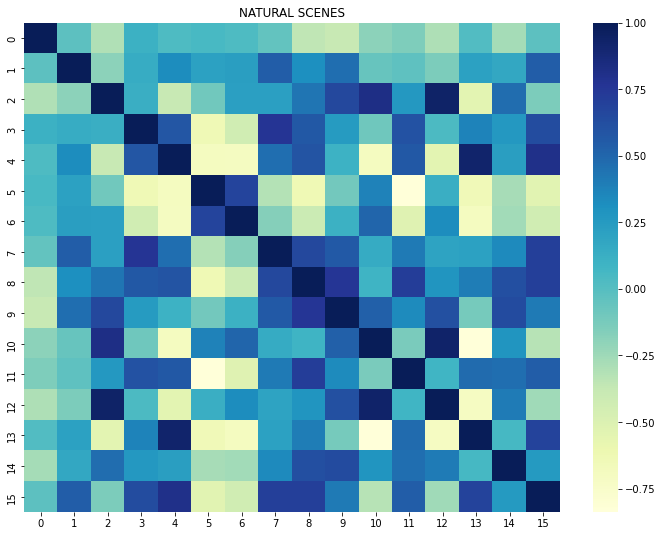

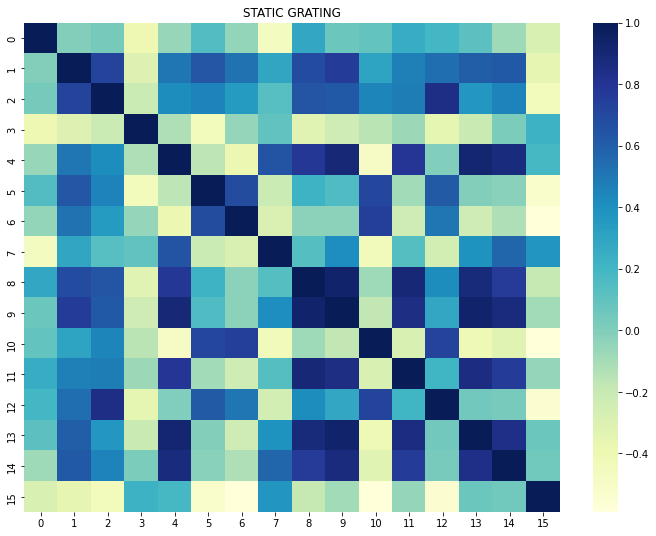

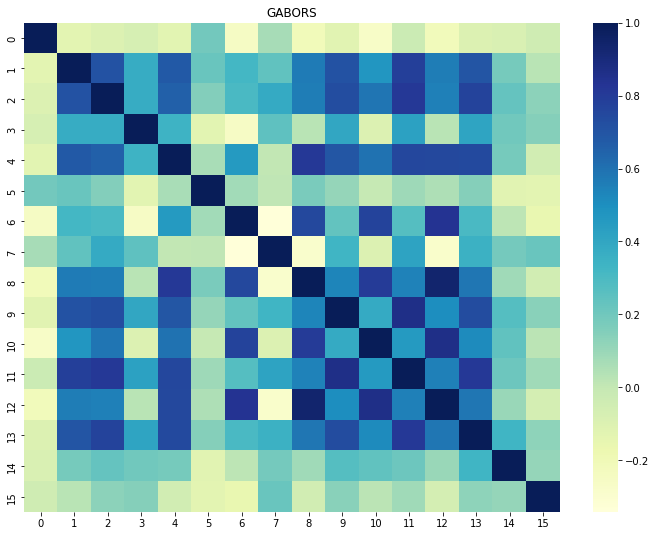

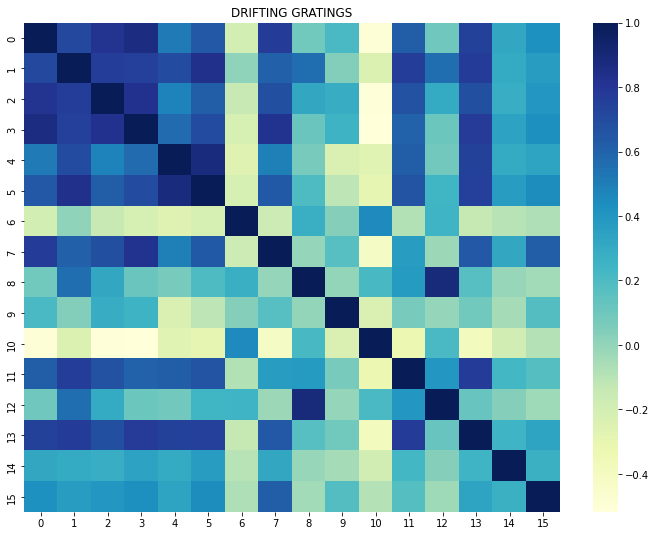

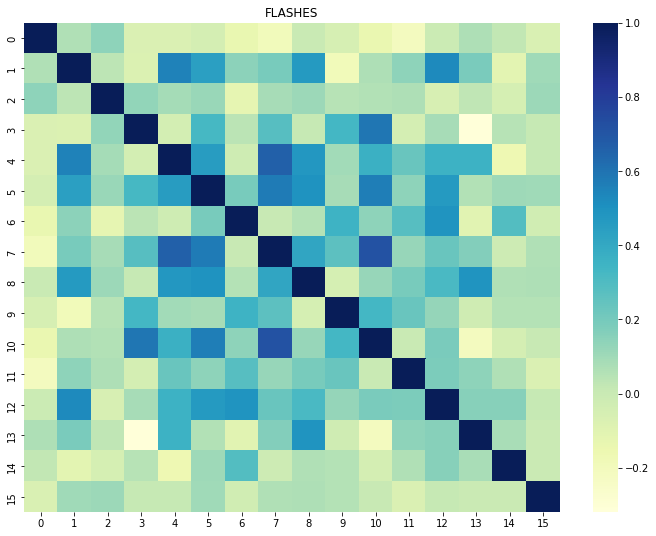

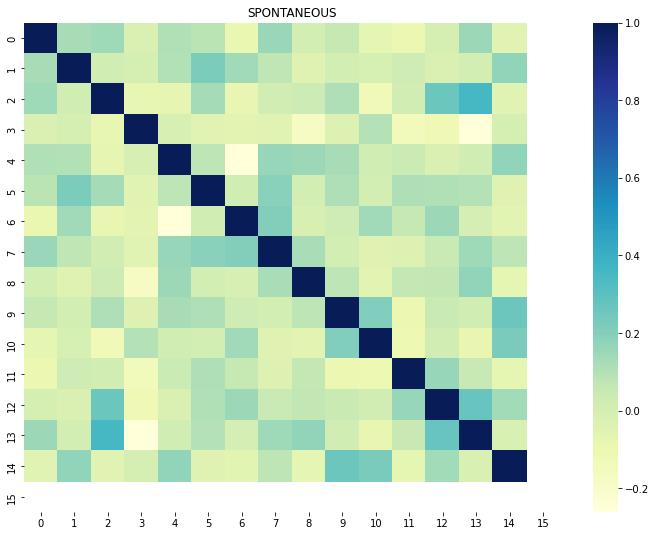

In [ ]:
plot_correlated_heatmap(natural_movie_one.index.values,Visual_cortex_units.index.values,'NATURAL MOVIE ONE')
plot_correlated_heatmap(natural_movie_three.index.values,Visual_cortex_units.index.values,'NATURAL MOVIE THREE')
plot_correlated_heatmap(natural_scenes_stimulus.index.values,Visual_cortex_units.index.values,'NATURAL SCENES')
plot_correlated_heatmap(static_grating_stimulus.index.values,Visual_cortex_units.index.values,'STATIC GRATING')
plot_correlated_heatmap(gabors_stimulus.index.values,Visual_cortex_units.index.values,'GABORS')
plot_correlated_heatmap(drifting_gratings_stimulus.index.values,Visual_cortex_units.index.values,'DRIFTING GRATINGS')
plot_correlated_heatmap(flashes_stimulus.index.values,Visual_cortex_units.index.values,'FLASHES')
plot_correlated_heatmap(spontaneous_stimulus.index.values,Visual_cortex_units.index.values,'SPONTANEOUS')

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9), (9, 10), (10, 11), (11, 12), (12, 13), (13, 14), (14, 15), (15, 16), (16, 17), (17, 18), (18, 19), (19, 20), (20, 21), (21, 22), (22, 23), (23, 24), (24, 25), (25, 26), (26, 27), (27, 28), (28, 29), (29, 30), (30, 31), (31, 32), (32, 33), (33, 34), (34, 35), (35, 36), (36, 37), (37, 38), (38, 39), (39, 40), (40, 41), (41, 42), (42, 43), (43, 44), (44, 45), (45, 46), (46, 47), (47, 48), (48, 49), (49, 50), (50, 51), (51, 52), (52, 53), (53, 54), (54, 55), (55, 56), (56, 57), (57, 58), (58, 59), (59, 60), (60, 61), (61, 62), (62, 63), (63, 64), (64, 65), (65, 66), (66, 67), (67, 68), (68, 69), (69, 70), (70, 71), (71, 72), (72, 73), (73, 74), (74, 75), (75, 76), (76, 77), (77, 78), (78, 79), (79, 80), (80, 81), (81, 82), (82, 83), (8

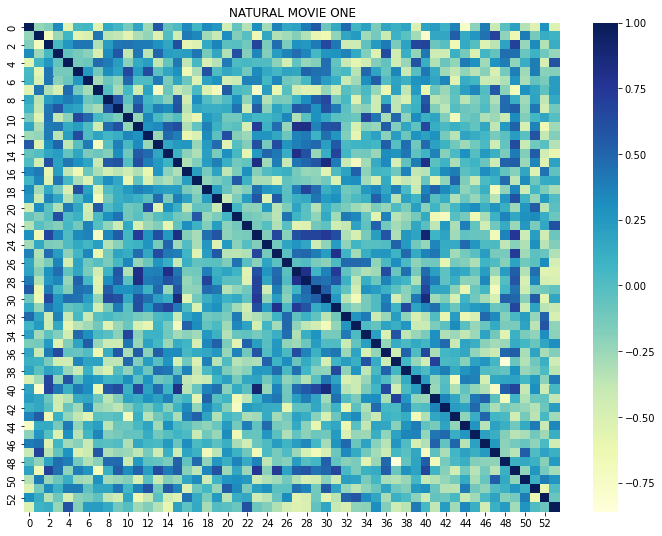

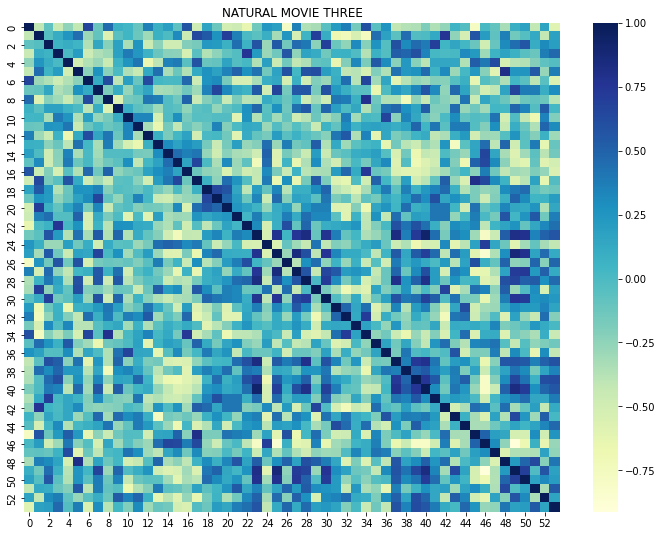

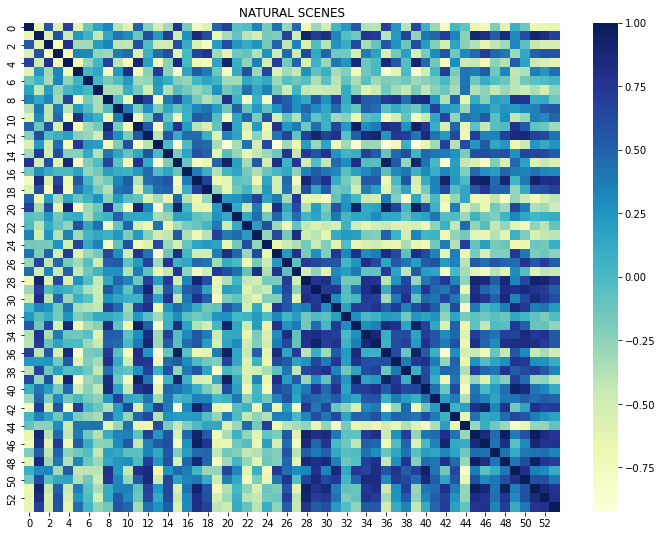

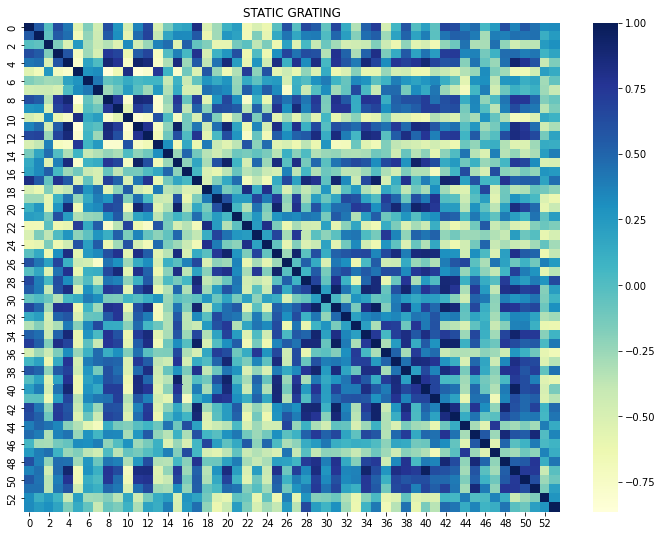

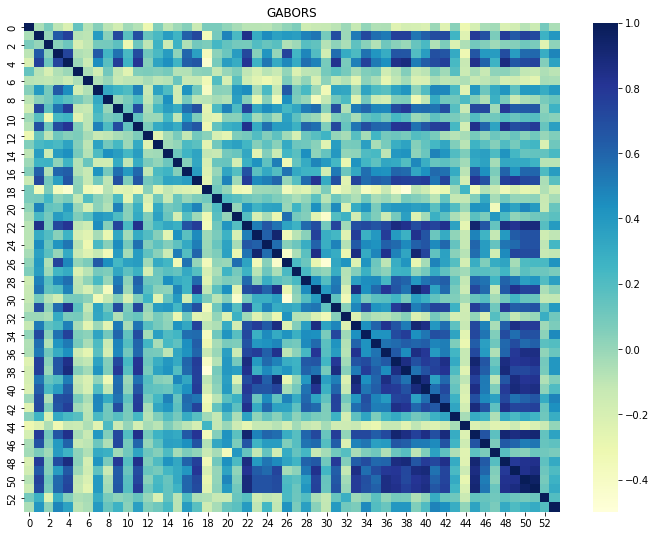

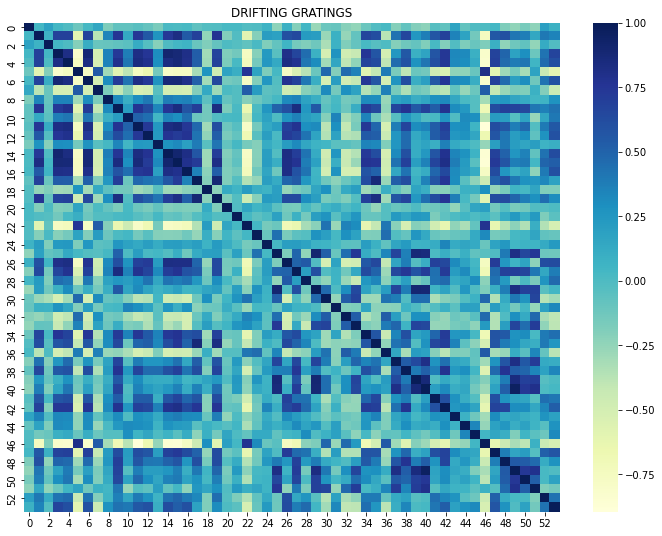

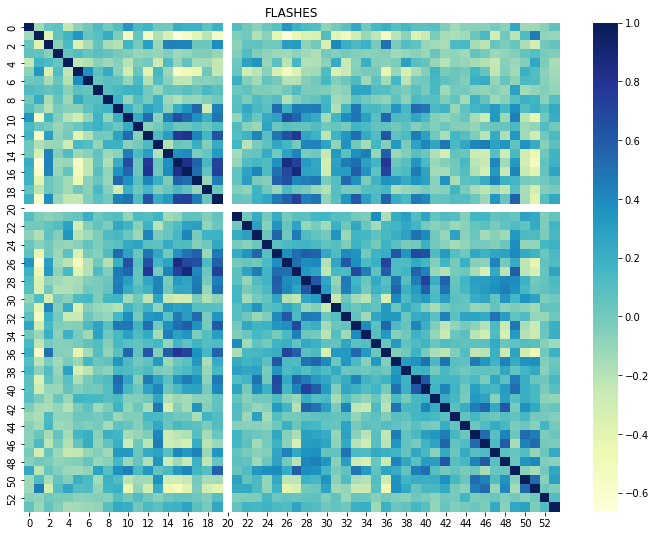

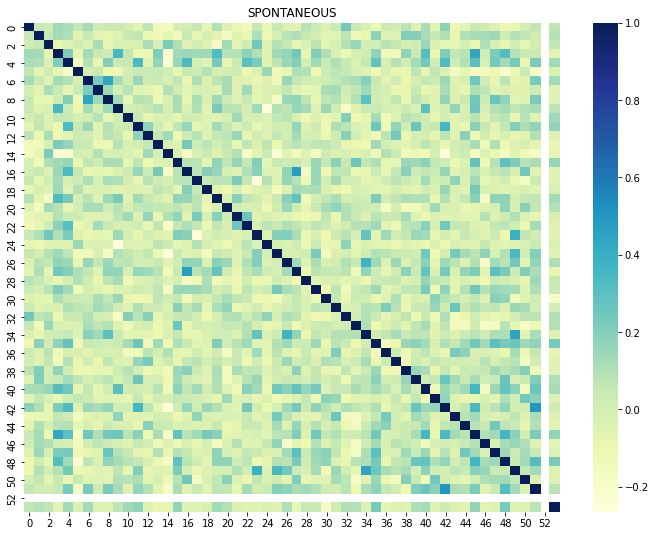

In [ ]:
plot_correlated_heatmap(natural_movie_one.index.values,snr_2_units.index.values,'NATURAL MOVIE ONE')
plot_correlated_heatmap(natural_movie_three.index.values,snr_2_units.index.values,'NATURAL MOVIE THREE')
plot_correlated_heatmap(natural_scenes_stimulus.index.values,snr_2_units.index.values,'NATURAL SCENES')
plot_correlated_heatmap(static_grating_stimulus.index.values,snr_2_units.index.values,'STATIC GRATING')
plot_correlated_heatmap(gabors_stimulus.index.values,snr_2_units.index.values,'GABORS')
plot_correlated_heatmap(drifting_gratings_stimulus.index.values,snr_2_units.index.values,'DRIFTING GRATINGS')
plot_correlated_heatmap(flashes_stimulus.index.values,snr_2_units.index.values,'FLASHES')
plot_correlated_heatmap(spontaneous_stimulus.index.values,snr_2_units.index.values,'SPONTANEOUS')

In [ ]:
time_step = 0.005
time_bins = np.arange(-0.1,0.5+time_step,time_step)
#histogram = session.presentationwise_spike_counts(stimulus_presentation_ids=49432,bin_edges=time_bins,unit_ids =Visual_cortex_units.index.values)
histogram = session.presentationwise_spike_counts(stimulus_presentation_ids=static_grating_sessions.index.values,bin_edges=time_bins,unit_ids =Visual_cortex_units.index.values )

/usr/local/lib/python3.7/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:760: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9), (9, 10), (10, 11), (11, 12), (12, 13), (13, 14), (14, 15), (15, 16), (16, 17), (17, 18), (18, 19), (19, 20), (20, 21), (21, 22), (22, 23), (23, 24), (24, 25), (25, 26), (26, 27), (27, 28), (28, 29), (29, 30), (30, 31), (31, 32), (32, 33), (33, 34), (34, 35), (35, 36), (36, 37), (37, 38), (38, 39), (39, 40), (40, 41), (41, 42), (42, 43), (43, 44), (44, 45), (45, 46), (46, 47), (47, 48), (48, 49), (49, 50), (50, 51), (51, 52), (52, 53), (53, 54), (54, 55), (55, 56), (56, 57), (57, 58), (58, 59), (59, 60), (60, 61), (61, 62), (62, 63), (63, 64), (64, 65), (65, 66), (66, 67), (67, 68), (68, 69), (69, 70), (70, 71), (71, 72), (72, 73), (73, 74), (74, 75), (75, 76), (76, 77), (77, 78), (78, 79), (79, 80), (80, 81), (81, 82), (82, 83), (8

In [ ]:
type(histogram)

xarray.core.dataarray.DataArray

In [ ]:
histogram.shape

(6000, 120, 16)

So histogram is of xarray data set , 3 dimensional data with shape 6000X60X60

In [ ]:
histogram.coords

Coordinates:
  * stimulus_presentation_id         (stimulus_presentation_id) int64 49432 ... 70387
  * time_relative_to_stimulus_onset  (time_relative_to_stimulus_onset) float64 -0.0975 ... 0.4975
  * unit_id                          (unit_id) int64 950930340 ... 950932696

Compressing the data by taking mean along stimulus presentation_id

In [ ]:
mean_histogram = histogram.mean(dim='stimulus_presentation_id')

In [ ]:
type(mean_histogram)

xarray.core.dataarray.DataArray

In [ ]:
mean_histogram.shape

(120, 16)

In [ ]:
stimulus_table[stimulus_table['stimulus_block']==3]['stimulus_name'].value_counts()
#flashes
#drifting gratings
#natural movie three
#

natural_movie_three    18000
Name: stimulus_name, dtype: int64